In [47]:
import json
import itertools

import matplotlib.pyplot as plt
from matplotlib.cm import ScalarMappable
from matplotlib.colors import Normalize
import pandas as pd
import seaborn as sns

from matplotlib import rcParams
rcParams['figure.figsize'] = 8, 8

In [48]:
def save_fig(fig, name):
    fig.savefig("./graphs/" + name + ".pdf", format="pdf")

In [49]:
def fix_status(df_line):
    if df_line.status != "UNKNOWN":
        return df_line.status

    if df_line.objectives != {}:
        return "SATISFIABLE"

    return df_line.status

In [50]:
def get_optimal_solution(df_line):
    if df_line.status != "OPTIMAL_SOLUTION":
        return None

    return min(df_line.objectives.values())

In [51]:
with open("results/freeda-vs-zephyrus-32x32x3.json", "r") as f:
    results = json.load(f)

dfs = []
for k, v in results.items():
    x = pd.DataFrame(v).assign(**{
        "solver" : k
    })

    # Add test features
    test_feature = pd.DataFrame(
        x.problem.apply(lambda s : s.split("/")[-1][:-4].split("_")).tolist(),
        columns=["components", "flavours", "nodes", "resources", "comps_topology", "infra_topology", "test"]
    ).assign(**{
        "components" : lambda df : df.components.apply(lambda x : int(x[1:])),
        "flavours": 1, # lambda df : df.flavours.apply(lambda x : int(x[1:])),
        "nodes" : lambda df : df.nodes.apply(lambda x : int(x[1:])),
        "resources" : 1, # lambda df : df.resources.apply(lambda x : int(x[1:])),
        "comps_topology" : lambda df : df.comps_topology.apply(lambda x : x[1:].upper()),
        "infra_topology" : lambda df : df.infra_topology.apply(lambda x : x[1:].upper()),
        "test" : lambda df : df.test.apply(lambda x : int(x))
    }).assign(**{
        "model": x.problem.apply(lambda s : s.split("/")[-2].upper()).tolist(),
    })

    dfs.append(
        pd.merge(
            left=x,
            right=test_feature,
            right_index=True,
            left_index=True,
        )
    )

df = pd.concat(dfs).rename(columns={"model_y" : "model"}).assign(**{
    # Corrections for unkown status codes
    "solve_time" : lambda df : df.apply(
        lambda x :
            300
            if "UNKNOWN" in x["status"]
            else x.solve_time - x.flat_time,
        axis=1),
    "status" : lambda df : df.apply(
        lambda x : fix_status(x),
    axis=1),
}).replace({ # Rename some stuff
    "cpsatlp": "OR-Tools",
    "gecode": "Gecode",
    "highs": "Highs",
    "chuffed": "Chuffed",
    "BARABASI": "small-world",
    "ERDOS": "random",
    "LADDER": "ladder",
    "WHEEL": "wheel",
    "PATH": "pipeline",
    "COMPLETE": "complete",
    "SATISFIABLE": "Satisfiable",
    "OPTIMAL_SOLUTION": "Optimal solution",
    "UNSATISFIABLE": "Unsatisfiable",
    "UNKNOWN": "Unknown",
    "ZEPHYRUS": "Zephyrus"
}).assign(optimal_solution=lambda df : df.apply(
    lambda x : min(x.objectives.values()) if "Optimal solution" in x.status else None, axis=1
)).drop(columns=["problem"]).reset_index(drop=True)
df

,status,flat_time,solve_time,objectives,solver,components,flavours,nodes,resources,comps_topology,infra_topology,test,model,optimal_solution
0,Optimal solution,0.550,0.024,{'0.574': 0},Chuffed,4,1,3,1,small-world,complete,0,FREEDA,0.0
1,Optimal solution,0.519,0.025,{'0.544': 3},Chuffed,4,1,3,1,small-world,complete,1,FREEDA,3.0
2,Optimal solution,0.507,0.032,"{'0.538': 8, '0.539': 1}",Chuffed,4,1,3,1,small-world,complete,2,FREEDA,1.0
3,Optimal solution,0.150,0.021,"{'0.17': 11, '0.171': 2}",Chuffed,4,1,3,1,small-world,complete,0,Zephyrus,2.0
4,Optimal solution,0.153,0.020,"{'0.172': 18, '0.173': 3}",Chuffed,4,1,3,1,small-world,complete,1,Zephyrus,3.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
46939,Optimal solution,1.024,0.555,"{'1.29': 4, '1.399': 3, '1.472': 1}",OR-Tools,32,1,32,1,pipeline,complete,1,FREEDA,1.0
46940,Optimal solution,1.023,0.801,"{'1.295': 8, '1.407': 6, '1.507': 5, '1.607': ...",OR-Tools,32,1,32,1,pipeline,complete,2,FREEDA,1.0
46941,Optimal solution,21.428,25.530,"{'30.035': 6, '32.847': 5, '35.681': 4, '38.50...",OR-Tools,32,1,32,1,pipeline,complete,0,Zephyrus,1.0
46942,Optimal solution,21.559,22.839,"{'30.068': 6, '32.884': 5, '35.694': 4, '38.5'...",OR-Tools,32,1,32,1,pipeline,complete,1,Zephyrus,1.0


# Clean up

In [52]:
df = df.query("infra_topology == 'complete'")

In [53]:
df = df.query("components <= 32").query("nodes <= 32")

In [54]:
check = (df
    .reset_index().rename(columns={"index": "drop_index"})
    .query("status == 'Optimal solution'")
    .drop(columns=["status", "flavours", "resources", "flat_time", "solve_time", "infra_topology", "objectives"])
    .groupby(["components", "nodes", "comps_topology", "test", "solver"], as_index=False)
)

different_objectives = []
not_both_tests = []
for a, group in check:
    if len(group) != 2:
        not_both_tests.append(group)
        continue

    os1 = group.iloc[0].optimal_solution
    os2 = group.iloc[1].optimal_solution
    if os1 != os2:
        different_objectives.append(group)

In [55]:
pd.concat(not_both_tests).drop_duplicates()

,drop_index,solver,components,nodes,comps_topology,test,model,optimal_solution
7764,7764,Chuffed,18,15,small-world,0,FREEDA,1.0
40076,40076,OR-Tools,20,11,random,2,FREEDA,1.0
40399,40399,OR-Tools,20,29,random,1,FREEDA,1.0
41426,41426,OR-Tools,22,26,random,2,FREEDA,1.0
41550,41550,OR-Tools,23,3,random,0,FREEDA,2.0
...,...,...,...,...,...,...,...,...
15630,15630,Chuffed,32,32,small-world,0,FREEDA,1.0
46926,46926,OR-Tools,32,32,small-world,0,FREEDA,1.0
15631,15631,Chuffed,32,32,small-world,1,FREEDA,1.0
46927,46927,OR-Tools,32,32,small-world,1,FREEDA,1.0


In [56]:
pd.concat(different_objectives).drop_duplicates()

,drop_index,solver,components,nodes,comps_topology,test,model,optimal_solution
0,0,Chuffed,4,3,small-world,0,FREEDA,0.0
3,3,Chuffed,4,3,small-world,0,Zephyrus,2.0
15648,15648,Highs,4,3,small-world,0,FREEDA,0.0
15651,15651,Highs,4,3,small-world,0,Zephyrus,2.0
31296,31296,OR-Tools,4,3,small-world,0,FREEDA,0.0
...,...,...,...,...,...,...,...,...
4155,4155,Chuffed,11,24,random,0,Zephyrus,1.0
19800,19800,Highs,11,24,random,0,FREEDA,0.0
19803,19803,Highs,11,24,random,0,Zephyrus,1.0
35448,35448,OR-Tools,11,24,random,0,FREEDA,0.0


In [57]:
df = (df
    .drop(index=pd.concat(not_both_tests).drop_index)
    .drop(index=pd.concat(different_objectives).drop_index)
)
df

,status,flat_time,solve_time,objectives,solver,components,flavours,nodes,resources,comps_topology,infra_topology,test,model,optimal_solution
1,Optimal solution,0.519,0.025,{'0.544': 3},Chuffed,4,1,3,1,small-world,complete,1,FREEDA,3.0
2,Optimal solution,0.507,0.032,"{'0.538': 8, '0.539': 1}",Chuffed,4,1,3,1,small-world,complete,2,FREEDA,1.0
4,Optimal solution,0.153,0.020,"{'0.172': 18, '0.173': 3}",Chuffed,4,1,3,1,small-world,complete,1,Zephyrus,3.0
5,Optimal solution,0.148,0.018,"{'0.164': 5, '0.165': 2, '0.166': 1}",Chuffed,4,1,3,1,small-world,complete,2,Zephyrus,1.0
6,Optimal solution,0.581,0.027,"{'0.607': 6, '0.608': 2}",Chuffed,4,1,3,1,random,complete,0,FREEDA,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
46939,Optimal solution,1.024,0.555,"{'1.29': 4, '1.399': 3, '1.472': 1}",OR-Tools,32,1,32,1,pipeline,complete,1,FREEDA,1.0
46940,Optimal solution,1.023,0.801,"{'1.295': 8, '1.407': 6, '1.507': 5, '1.607': ...",OR-Tools,32,1,32,1,pipeline,complete,2,FREEDA,1.0
46941,Optimal solution,21.428,25.530,"{'30.035': 6, '32.847': 5, '35.681': 4, '38.50...",OR-Tools,32,1,32,1,pipeline,complete,0,Zephyrus,1.0
46942,Optimal solution,21.559,22.839,"{'30.068': 6, '32.884': 5, '35.694': 4, '38.5'...",OR-Tools,32,1,32,1,pipeline,complete,1,Zephyrus,1.0


In [58]:
#result_df.to_csv("./results.csv", index=False)

In [59]:
#df = df.query("status != 'UNSATISFIABLE'")

In [60]:
models = df.model.unique().tolist()
solvers = df.solver.unique()
component_topologies = df.comps_topology.unique()
infrastructure_topologies = df.infra_topology.unique()
tests = df.test.unique()
alpha = 1.0 / len(tests)
statuses = df.status.unique()

In [61]:
color = {
    "Chuffed" : "red",
    "OR-Tools": "cyan",
    "Gecode" : "blue",
    "Highs" : "black"
}

marker = {
    "Chuffed" : ".",
    "OR-Tools": "_",
    "Gecode" : "x",
    "Highs" : "2"
}

In [62]:
df

,status,flat_time,solve_time,objectives,solver,components,flavours,nodes,resources,comps_topology,infra_topology,test,model,optimal_solution
1,Optimal solution,0.519,0.025,{'0.544': 3},Chuffed,4,1,3,1,small-world,complete,1,FREEDA,3.0
2,Optimal solution,0.507,0.032,"{'0.538': 8, '0.539': 1}",Chuffed,4,1,3,1,small-world,complete,2,FREEDA,1.0
4,Optimal solution,0.153,0.020,"{'0.172': 18, '0.173': 3}",Chuffed,4,1,3,1,small-world,complete,1,Zephyrus,3.0
5,Optimal solution,0.148,0.018,"{'0.164': 5, '0.165': 2, '0.166': 1}",Chuffed,4,1,3,1,small-world,complete,2,Zephyrus,1.0
6,Optimal solution,0.581,0.027,"{'0.607': 6, '0.608': 2}",Chuffed,4,1,3,1,random,complete,0,FREEDA,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
46939,Optimal solution,1.024,0.555,"{'1.29': 4, '1.399': 3, '1.472': 1}",OR-Tools,32,1,32,1,pipeline,complete,1,FREEDA,1.0
46940,Optimal solution,1.023,0.801,"{'1.295': 8, '1.407': 6, '1.507': 5, '1.607': ...",OR-Tools,32,1,32,1,pipeline,complete,2,FREEDA,1.0
46941,Optimal solution,21.428,25.530,"{'30.035': 6, '32.847': 5, '35.681': 4, '38.50...",OR-Tools,32,1,32,1,pipeline,complete,0,Zephyrus,1.0
46942,Optimal solution,21.559,22.839,"{'30.068': 6, '32.884': 5, '35.694': 4, '38.5'...",OR-Tools,32,1,32,1,pipeline,complete,1,Zephyrus,1.0


# DataFrame Analysis

In [63]:
df.status.unique()

array(['Optimal solution', 'Satisfiable', 'Unknown'], dtype=object)

In [64]:
df.status.value_counts(normalize=True)

status
Optimal solution    0.986881
Unknown             0.010517
Satisfiable         0.002602
Name: proportion, dtype: float64

In [65]:
df[["components", "status"]].groupby("components").value_counts()

components  status          
4           Optimal solution    1494
5           Optimal solution    1560
6           Optimal solution    1602
7           Optimal solution    1614
8           Optimal solution    1620
9           Optimal solution    1602
10          Optimal solution    1596
11          Optimal solution    1614
12          Optimal solution    1620
13          Optimal solution    1620
14          Optimal solution    1620
15          Optimal solution    1620
16          Optimal solution    1620
17          Optimal solution    1620
18          Optimal solution    1618
            Satisfiable            1
19          Optimal solution    1620
20          Optimal solution    1616
            Unknown                2
21          Optimal solution    1620
22          Optimal solution    1618
            Unknown                1
23          Optimal solution    1602
            Unknown                8
            Satisfiable            1
24          Optimal solution    1614
         

In [66]:
df[["nodes", "status"]].groupby("nodes").value_counts()

nodes  status          
3      Optimal solution    1530
       Unknown               15
4      Optimal solution    1528
       Unknown               13
5      Optimal solution    1524
                           ... 
31     Unknown               21
       Satisfiable            2
32     Optimal solution    1490
       Unknown               27
       Satisfiable            5
Name: count, Length: 88, dtype: int64

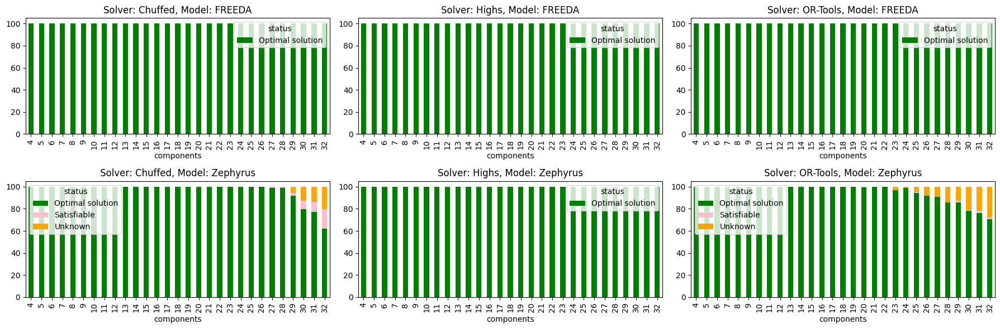

In [67]:
statuses = df.status.unique()

fig, axs = plt.subplots(
    nrows=2,
    ncols=len(solvers),
    figsize=(6 * len(solvers), 6)
)
norm = Normalize(vmin=0, vmax=100)
for model, ax_row in zip(models, axs):
    for solver, ax in zip(solvers, ax_row):
        d = (
            df.query("solver == @solver")
            .query("model == @model")
            [["components", "status"]]
            .groupby("components")
            .value_counts(normalize=True)
            * 100
        ).reset_index().pivot(
            index="components",
            columns="status",
            values="proportion"
        ).fillna(0)

        d.plot.bar(
            color={"Optimal solution": "green", "Unsatisfiable": "#1f77b4", "Unknown": "orange", "Satisfiable" : "pink"},
            stacked=True,
            ax=ax,
            title="Solver: " + solver + ", Model: " + model
        )

#fig.suptitle("Percentage of statuses")
fig.tight_layout()
plt.show()

In [68]:
pd.concat(
    [
        df[["components", "nodes", "status"]].groupby(["components", "nodes"]).value_counts(),
        df[["components", "nodes", "status"]].groupby(["components", "nodes"]).value_counts(normalize=True) * 100
    ],
    axis=1,
    keys=['counts', '%']
).reset_index()#.to_csv("./status_aggregated.csv", index=False)

,components,nodes,status,counts,%
0,4,3,Optimal solution,48,100.000000
1,4,4,Optimal solution,42,100.000000
2,4,5,Optimal solution,48,100.000000
3,4,6,Optimal solution,54,100.000000
4,4,7,Optimal solution,48,100.000000
...,...,...,...,...,...
1132,32,31,Unknown,7,15.217391
1133,32,31,Satisfiable,1,2.173913
1134,32,32,Optimal solution,34,77.272727
1135,32,32,Unknown,7,15.909091


<Axes: title={'center': 'Distribution of solve_time'}>

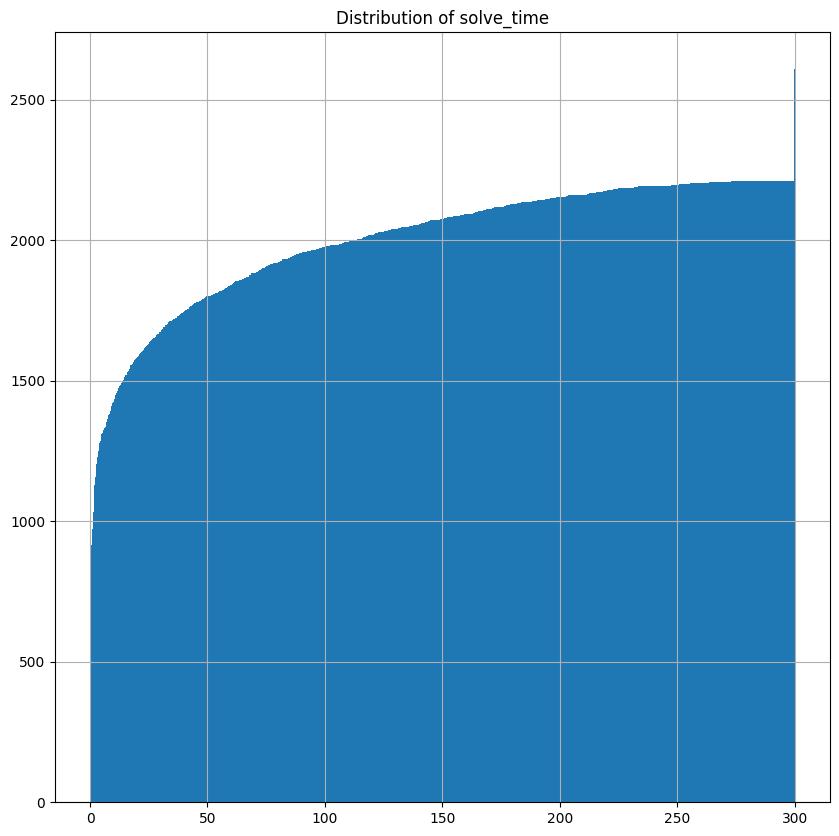

In [69]:
plt.figure(figsize=(10, 10))
plt.title("Distribution of solve_time")
vbs = df.sort_values("solve_time", ascending=False).groupby(["components", "nodes", "test"]).head(1)
vbs.solve_time.sort_values().hist(bins=1000, cumulative=True)

<Axes: title={'center': 'Distribution only for Optimal solutions'}>

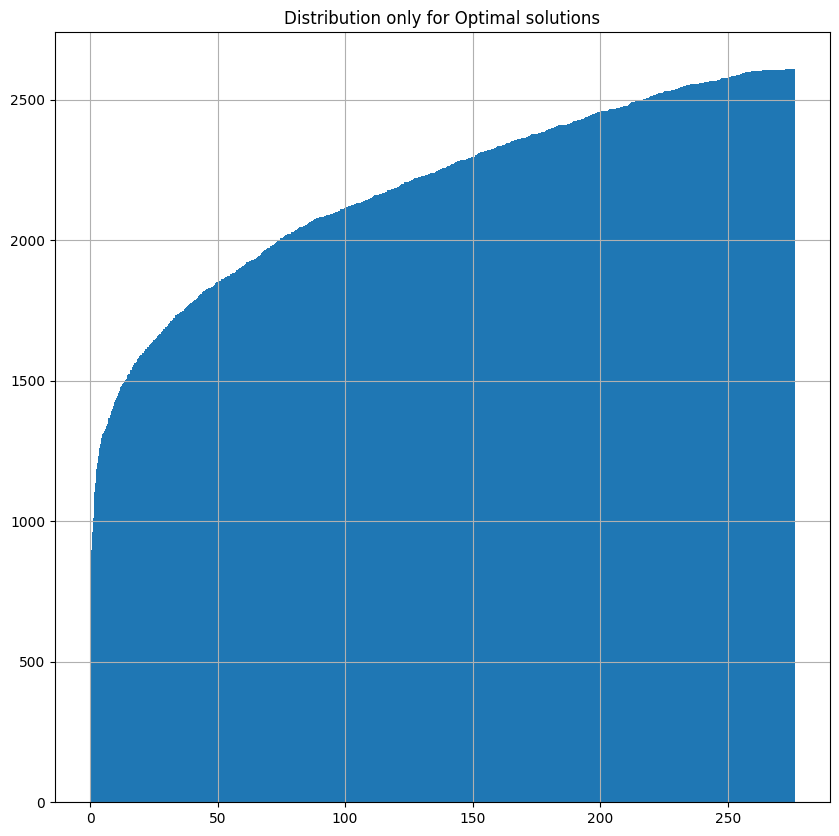

In [70]:
plt.figure(figsize=(10, 10))
plt.title("Distribution only for Optimal solutions")
vbs = df.query("status == 'Optimal solution'").sort_values("solve_time", ascending=False).groupby(["components", "nodes", "test"]).head(1)
vbs.solve_time.sort_values().hist(bins=1000, cumulative=True)

In [71]:
## Usefull with other data
#plt.figure(figsize=(10, 10))
#plt.title("Distribution without Gecode")
#vbs = df.query("solver != 'gecode'").sort_values("solve_time", ascending=False).groupby(["components", "nodes", "test"]).head(1)
#vbs.solve_time.sort_values().hist(bins=1000, cumulative=True)

# Solve Time

### Components

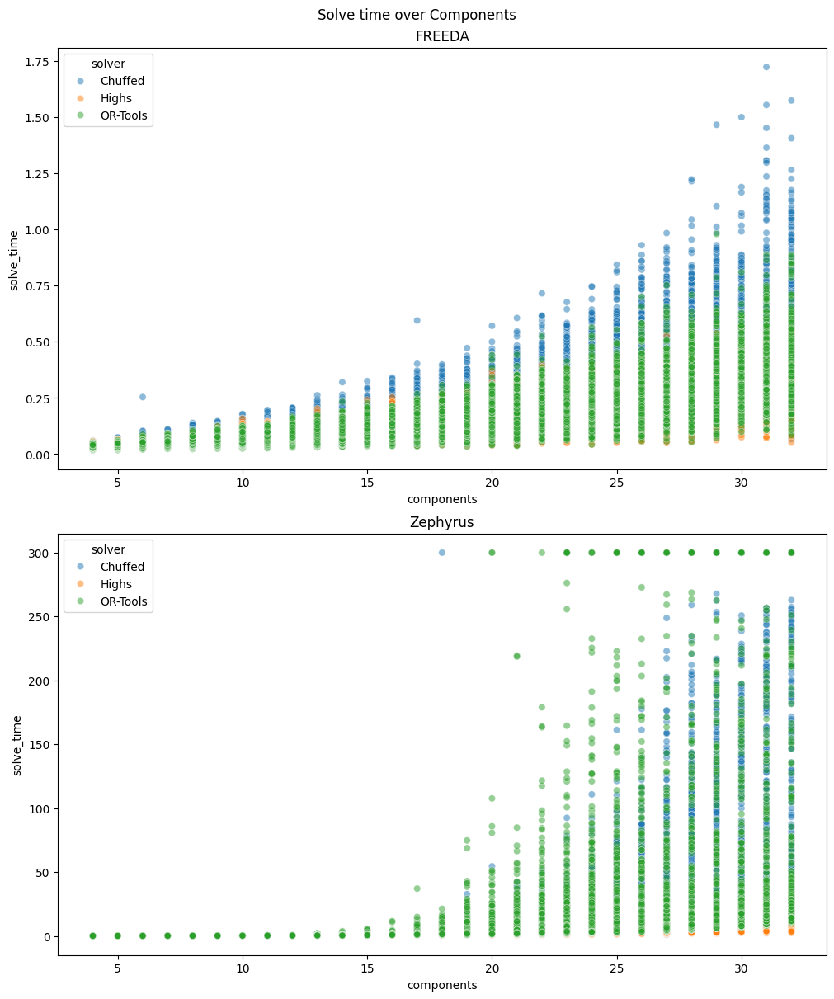

In [72]:
fig, axs = plt.subplots(len(models), 1, constrained_layout=True)
fig.suptitle("Solve time over Components")
fig.set_figheight(6 * len(models))
fig.set_figwidth(10)
for m, ax in zip(models, axs):
    ax.set_title(str(m))
    sns.scatterplot(
        data=df.query("model == @m"),
        x="components",
        y="solve_time",
        alpha=0.5,
        hue="solver",
        ax=ax
    )

### Nodes

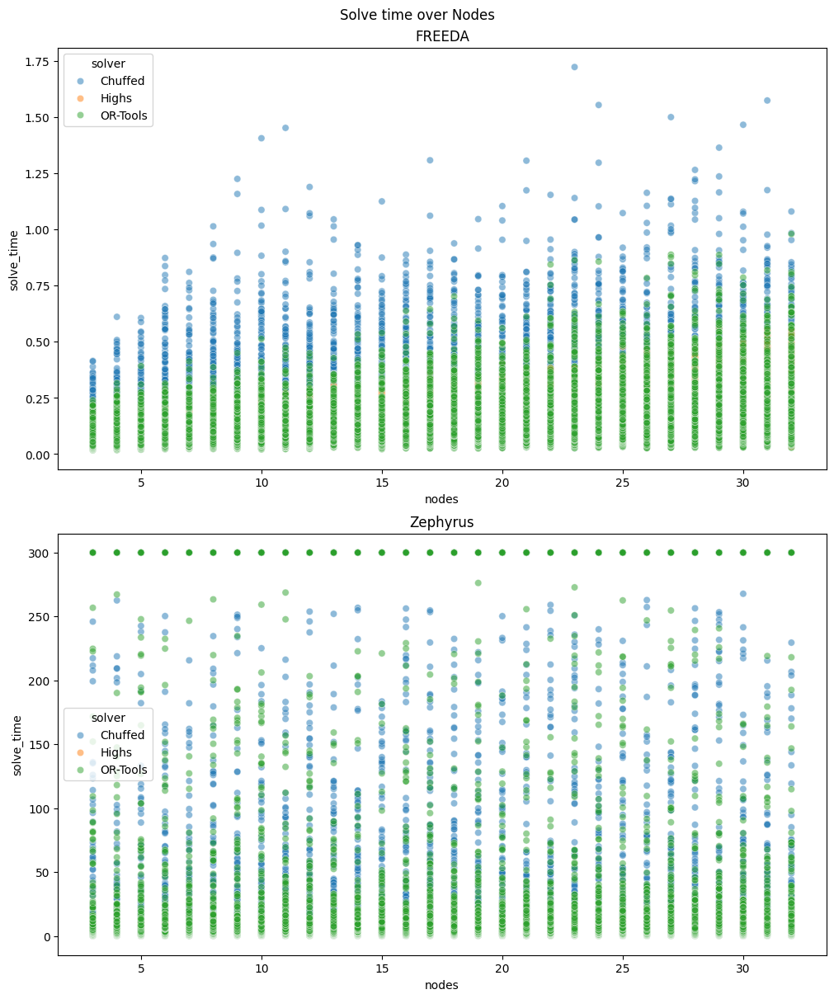

In [73]:
fig, axs = plt.subplots(len(models), 1, constrained_layout=True)
fig.suptitle("Solve time over Nodes")
fig.set_figheight(6 * len(models))
fig.set_figwidth(10)
for m, ax in zip(models, axs):
    ax.set_title(str(m))
    sns.scatterplot(
        data=df.query("model == @m"),
        x="nodes",
        y="solve_time",
        alpha=0.5,
        hue="solver",
        ax=ax
    )

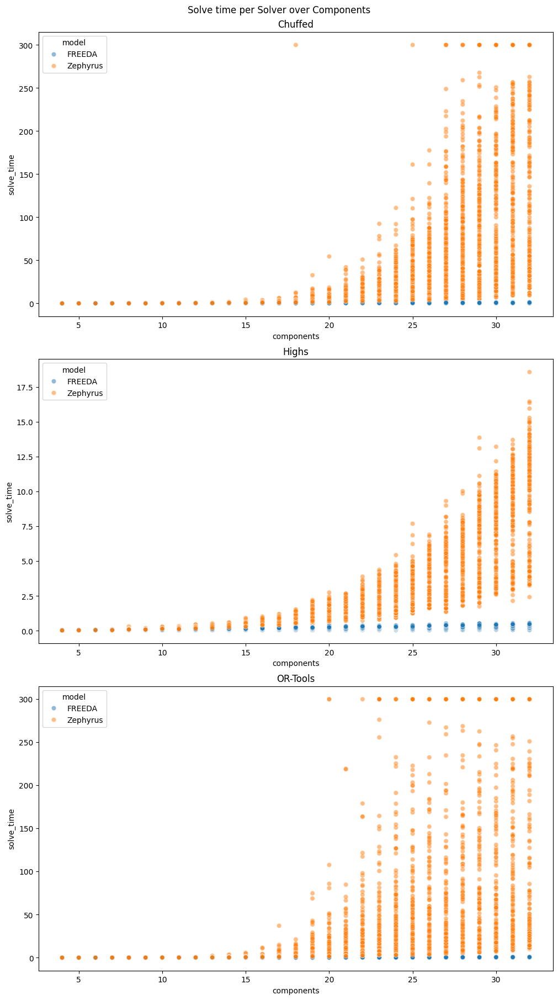

In [74]:
fig, axs = plt.subplots(len(solvers), 1, constrained_layout=True)
fig.suptitle("Solve time per Solver over Components")
fig.set_figheight(6 * len(solvers))
fig.set_figwidth(10)
for s, ax in zip(solvers, axs):
    ax.set_title(str(s))
    sns.scatterplot(
        data=df.query("solver == @s"),
        x="components",
        y="solve_time",
        alpha=0.5,
        hue="model",
        ax=ax
    )

### Components x nodes

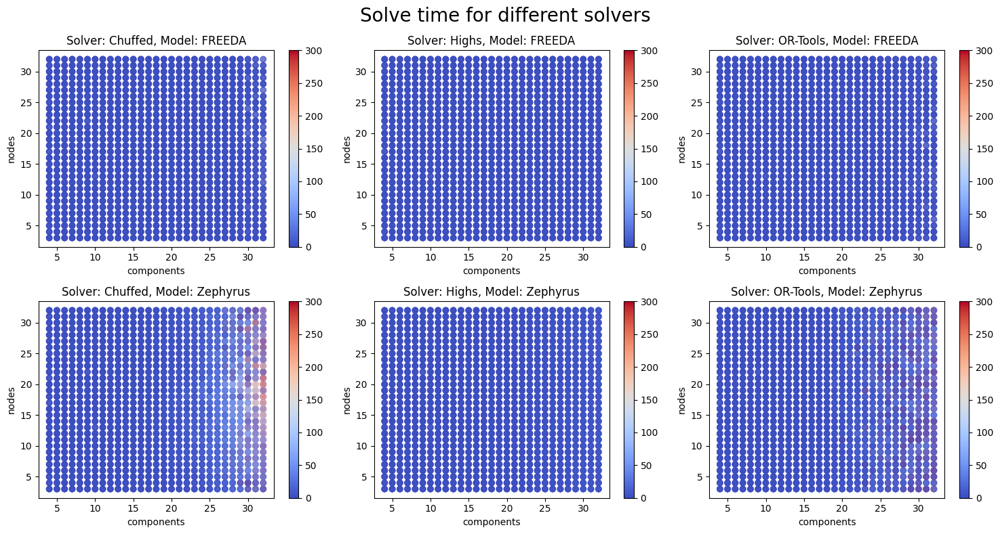

In [75]:
fig, axs = plt.subplots(
    nrows=len(models),
    ncols=len(solvers),
    figsize=(5 * len(solvers), 4 * len(models))
)
norm = Normalize(vmin=0, vmax=df.solve_time.max())
for m, ax_row in zip(models, axs):
    for s, ax in zip(solvers, ax_row):
        d = df.query("model == @m").query("solver == @s")
        ax.scatter(
            x=d.components,
            y=d.nodes,
            c=d.solve_time,
            cmap="coolwarm",
            norm=norm,
            alpha=alpha
        )
        ax.set_xlabel("components")
        ax.set_ylabel("nodes")
        ax.set_title("Solver: " + s + ", Model: " + m)
        fig.colorbar(ScalarMappable(norm=norm, cmap="coolwarm"), ax=ax, orientation='vertical')

fig.suptitle("Solve time for different solvers", fontsize=20)
fig.tight_layout()

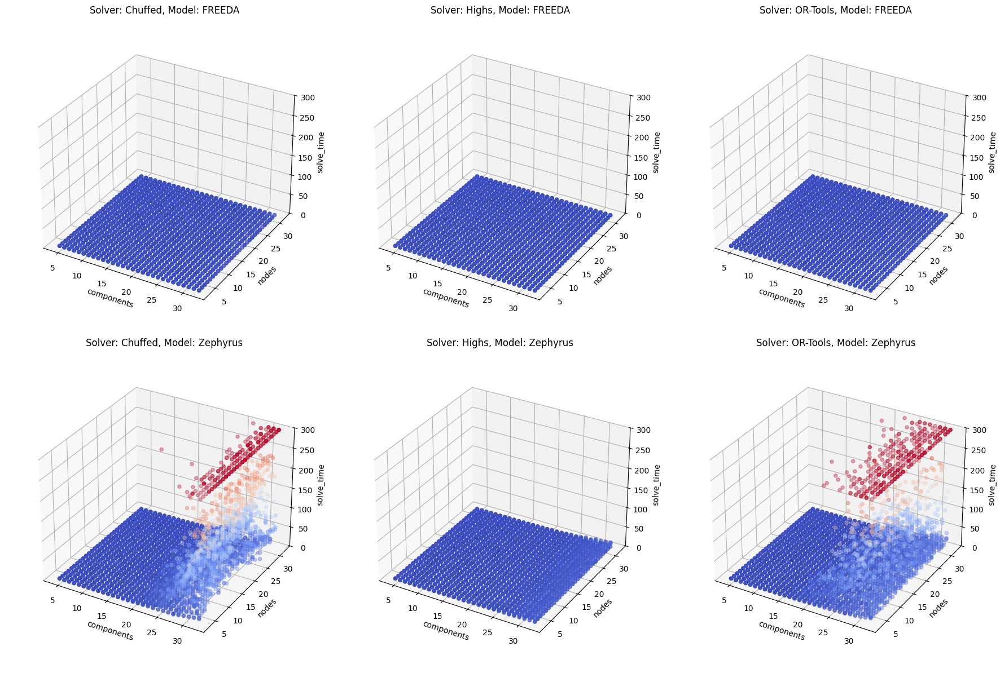

In [76]:
fig, axs = plt.subplots(
    nrows=len(models),
    ncols=len(solvers),
    figsize=(6 * len(solvers), 6 * len(models)),
    subplot_kw=dict(projection='3d')
)
norm = Normalize(vmin=0, vmax=df.solve_time.max())
for m, ax_row in zip(models, axs):
    for s, ax in zip(solvers, ax_row):
        d = df.query("model == @m").query("solver == @s")
        ax.scatter(
            xs=d.components,
            ys=d.nodes,
            zs=d.solve_time,
            c=d.solve_time,
            cmap="coolwarm",
            norm=norm,
            alpha=alpha
        )
        ax.set_xlabel("components")
        ax.set_ylabel("nodes")
        ax.set_zlabel("solve_time")
        ax.set_title("Solver: " + s + ", Model: " + m)
        ax.set_box_aspect(None, zoom=0.90)
        ax.set_zlim([0, 300])

fig.tight_layout()

### Topologies

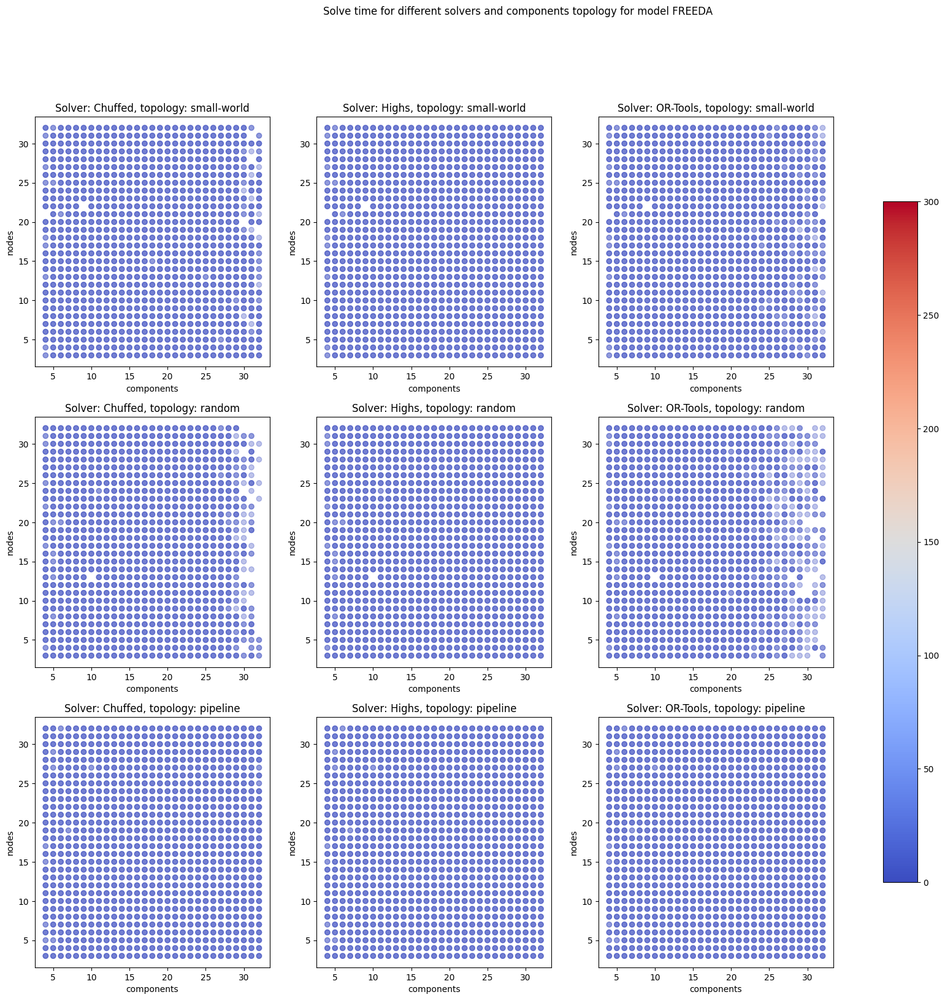

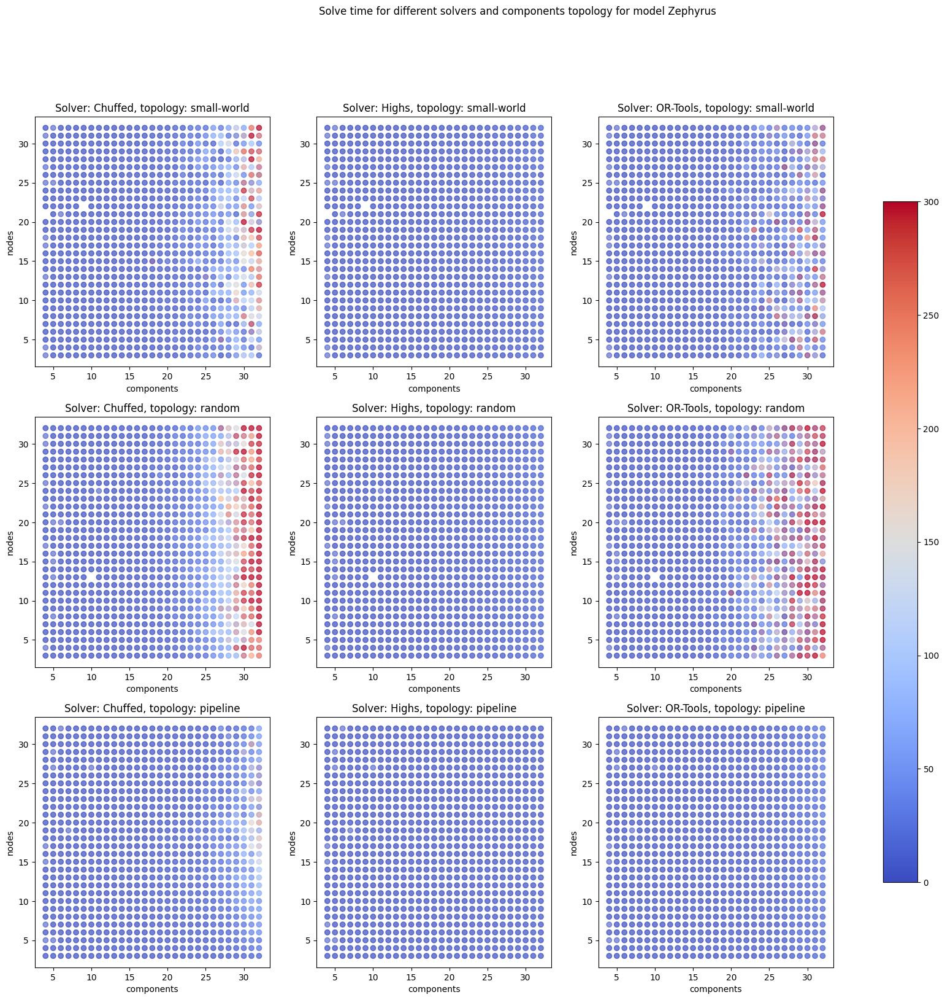

In [77]:
norm = Normalize(vmin=0, vmax=300)
for m in models:
    fig, axs = plt.subplots(
        nrows=len(component_topologies),
        ncols=len(solvers),
        figsize=(7 * len(component_topologies), 6 * len(solvers))
    )
    axs_reshaped = axs.reshape(-1)
    axis = itertools.product(component_topologies, solvers)
    df_model = df.query("model == @m")
    for (topology, solver), ax in zip(axis, axs_reshaped):
        d = df_model.query("solver == @solver").query("comps_topology == @topology")
        ax.scatter(
            x=d.components,
            y=d.nodes,
            c=d.solve_time,
            cmap="coolwarm",
            norm=norm,
            alpha=alpha
        )
        ax.set_xlabel("components")
        ax.set_ylabel("nodes")
        ax.set_title("Solver: " + solver + ", topology: " + topology)

    fig.suptitle("Solve time for different solvers and components topology for model " + m)
    fig.colorbar(
        ScalarMappable(norm=norm, cmap="coolwarm"),
        ax=axs.ravel().tolist(),
        orientation='vertical',
        shrink=0.8
    )

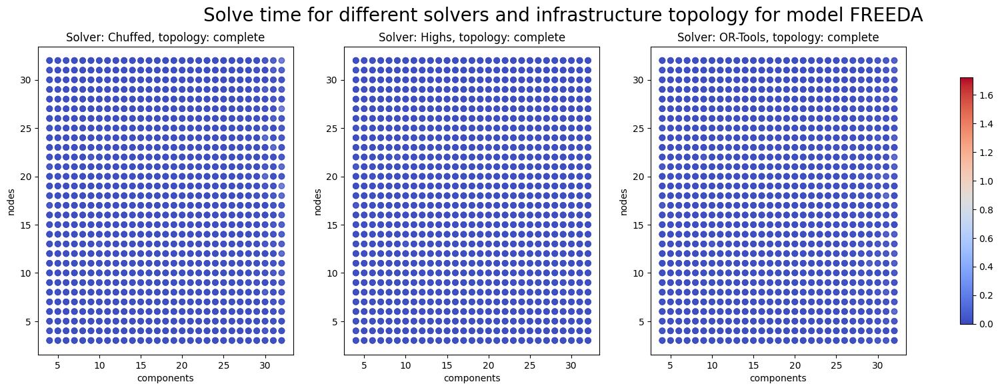

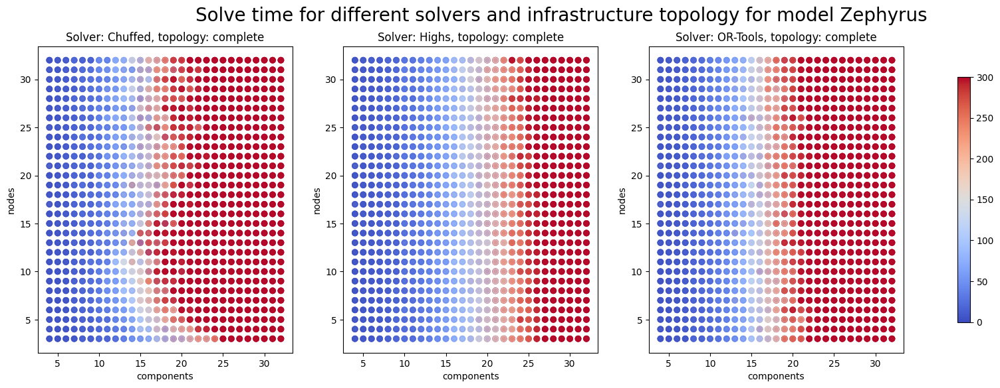

In [78]:
for m in models:
    fig, axs = plt.subplots(
        nrows=len(infrastructure_topologies),
        ncols=len(solvers),
        figsize=(7 * len(solvers), 6 * len(infrastructure_topologies))
    )
    axs_reshaped = axs.reshape(-1)
    axis = itertools.product(infrastructure_topologies, solvers)
    df_model = df.query("model == @m")
    for (topology, solver), ax in zip(axis, axs_reshaped):
        d = df_model.query("solver == @solver").query("infra_topology == @topology")
        ax.scatter(
            x=d.components,
            y=d.nodes,
            c=d.solve_time,
            cmap="coolwarm",
            norm=norm,
            alpha=1.0/len(d.test.unique())
        )
        ax.set_xlabel("components")
        ax.set_ylabel("nodes")
        ax.set_title("Solver: " + solver + ", topology: " + topology)

    norm = Normalize(vmin=0, vmax=df_model.solve_time.max())
    fig.colorbar(
        ScalarMappable(norm=norm, cmap="coolwarm"),
        ax=axs.ravel().tolist(),
        orientation='vertical',
        shrink=0.8
    )
    fig.suptitle("Solve time for different solvers and infrastructure topology for model " + m, fontsize=20)

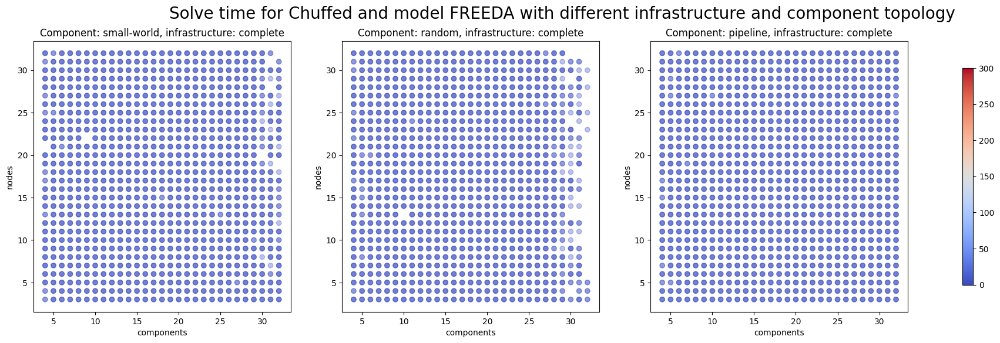

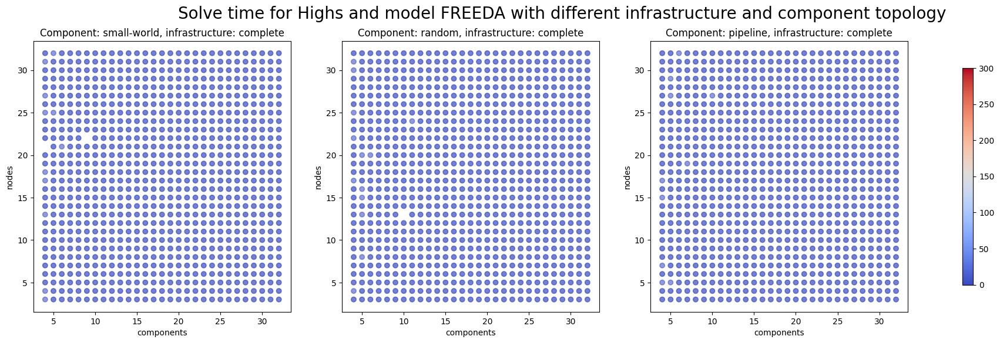

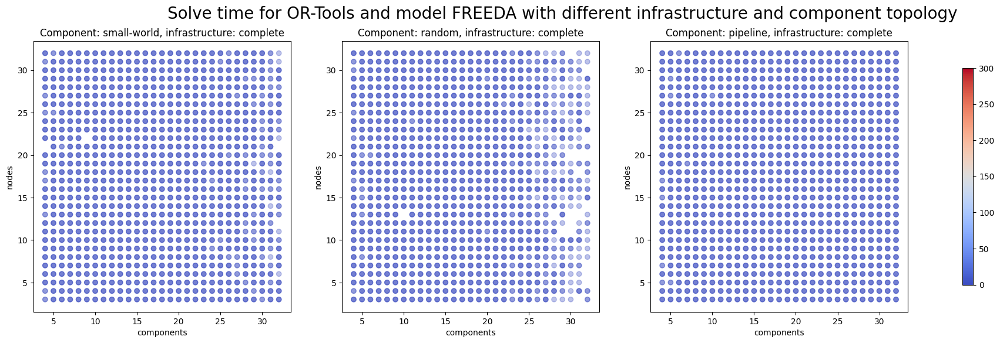

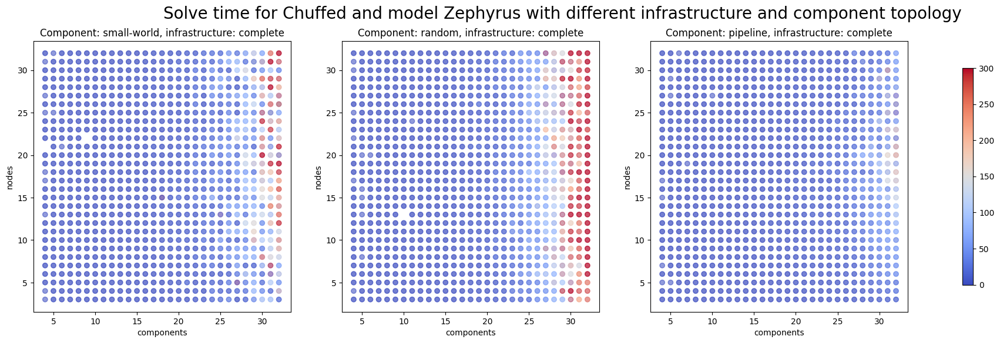

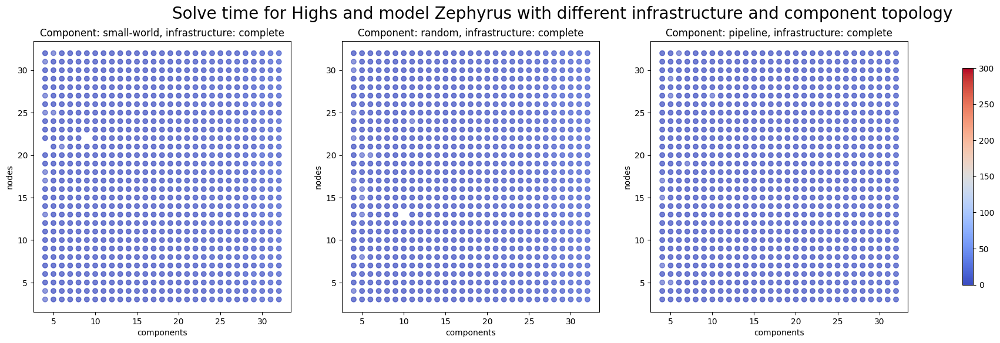

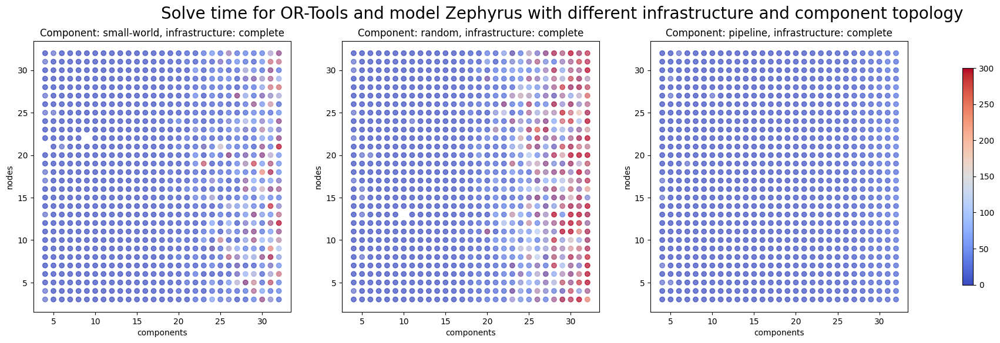

In [79]:
norm = Normalize(vmin=0, vmax=df.solve_time.max())
for m in models:
    for solver in solvers:
        fig, axs = plt.subplots(
            nrows=len(infrastructure_topologies),
            ncols=len(component_topologies),
            figsize=(8 * len(component_topologies), 6 * len(infrastructure_topologies))
        )
        axs_reshaped = axs.reshape(-1)
        axis = itertools.product(infrastructure_topologies, component_topologies)
        df_solver_problem = df.query("model == @m").query("solver == @solver")
        for (infra_topology, comps_topology), ax in zip(axis, axs_reshaped):
            d = df_solver_problem.query("infra_topology == @infra_topology").query("comps_topology == @comps_topology")
            ax.scatter(
                x=d.components,
                y=d.nodes,
                c=d.solve_time,
                cmap="coolwarm",
                norm=norm,
                alpha=1.0/len(d.test.unique())
            )
            ax.set_xlabel("components")
            ax.set_ylabel("nodes")
            ax.set_title("Component: " + comps_topology + ", infrastructure: " + infra_topology)

        fig.colorbar(
            ScalarMappable(norm=norm, cmap="coolwarm"),
            ax=axs.ravel().tolist(),
            orientation='vertical',
            shrink=0.8
        )
        fig.suptitle("Solve time for " + solver + " and model " + m + " with different infrastructure and component topology", fontsize=20)


# Flat time

### Components

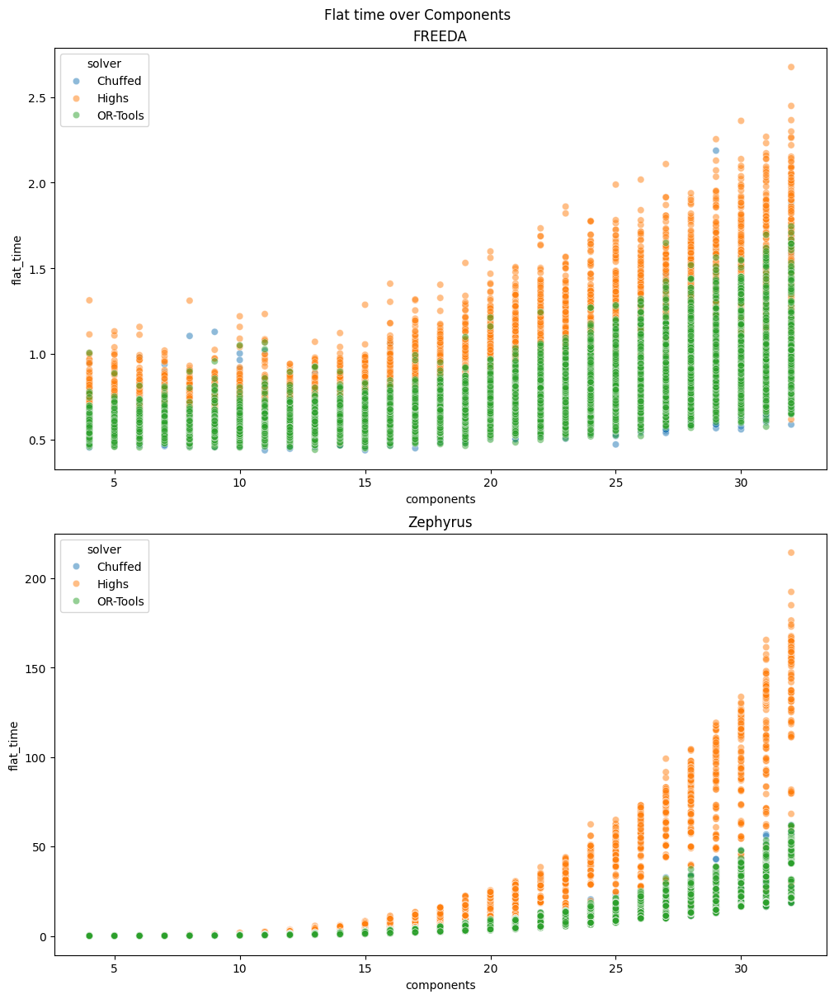

In [80]:
fig, axs = plt.subplots(len(models), 1, constrained_layout=True)
fig.suptitle("Flat time over Components")
fig.set_figheight(6 * len(models))
fig.set_figwidth(10)
for m, ax in zip(models, axs):
    ax.set_title(m)
    sns.scatterplot(
        data=df.query("model == @m"),
        x="components",
        y="flat_time",
        alpha=0.5,
        hue="solver",
        ax=ax
    )

### Nodes

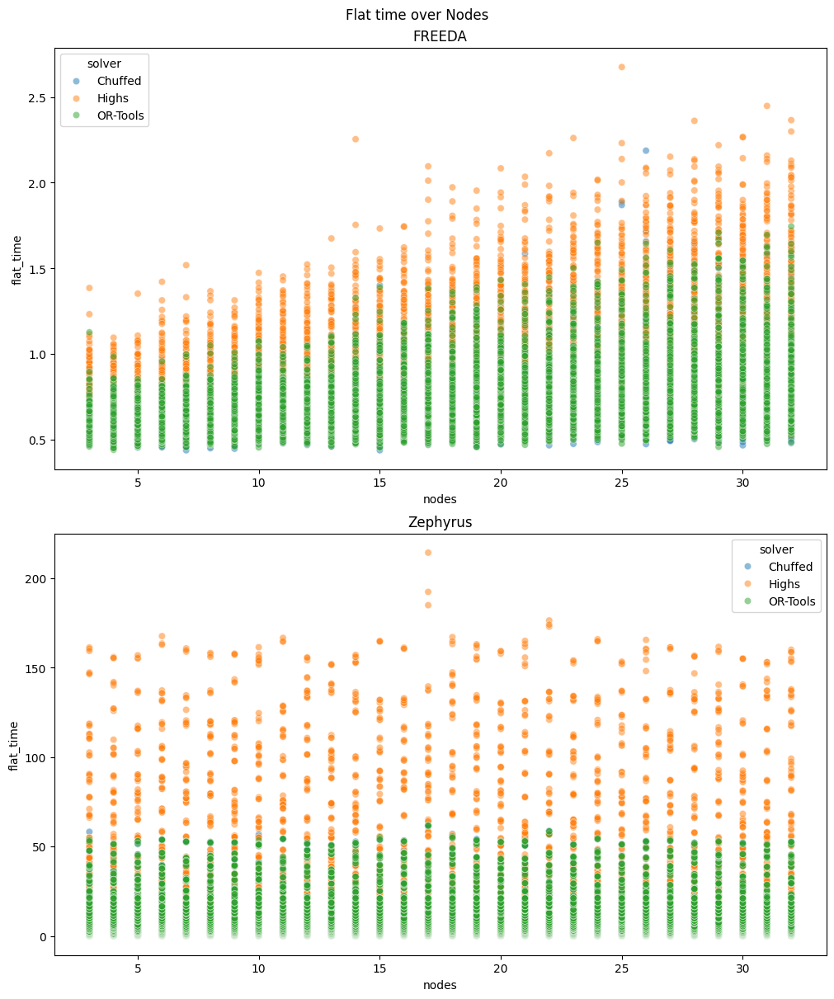

In [81]:
fig, axs = plt.subplots(len(models), 1, constrained_layout=True)
fig.suptitle("Flat time over Nodes")
fig.set_figheight(6 * len(models))
fig.set_figwidth(10)
for m, ax in zip(models, axs):
    ax.set_title(m)
    sns.scatterplot(
        data=df.query("model == @m"),
        x="nodes",
        y="flat_time",
        alpha=0.5,
        hue="solver",
        ax=ax
    )

### Components x nodes

Text(0.5, 0.98, 'Flat time for different solvers')

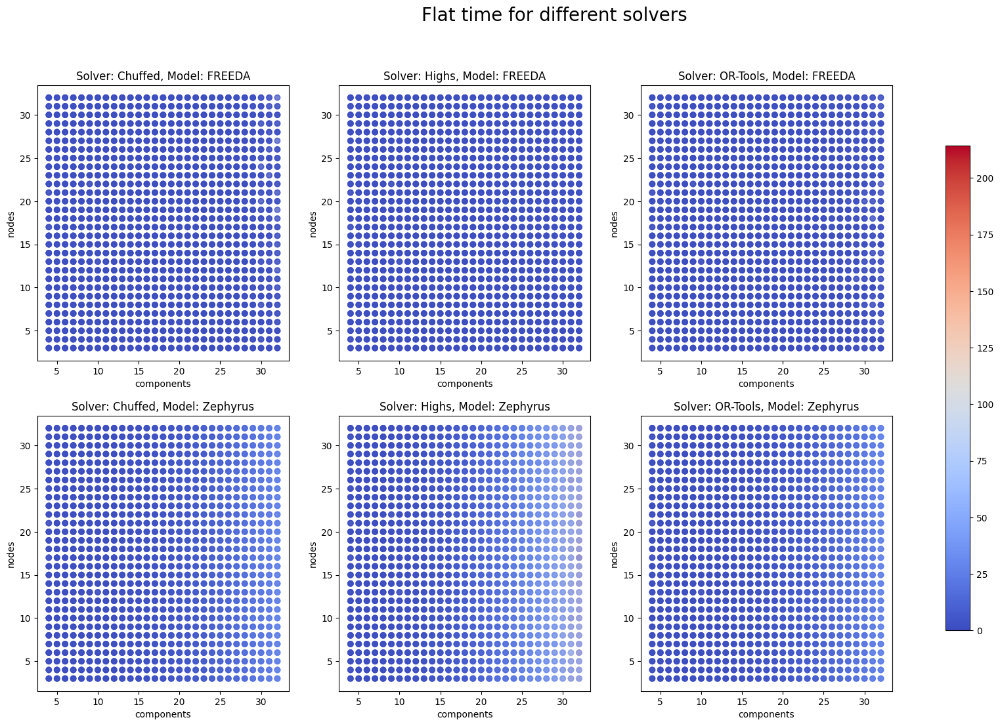

In [82]:
fig, axs = plt.subplots(
    nrows=len(models),
    ncols=len(solvers),
    figsize=(7 * len(solvers), 6 * len(models))
)
norm = Normalize(vmin=0, vmax=df.flat_time.max())
for m, ax_row in zip(models, axs):
    for s, ax in zip(solvers, ax_row):
        d = df.query("model == @m").query("solver == @s")
        ax.scatter(
            x=d.components,
            y=d.nodes,
            c=d.flat_time,
            cmap="coolwarm",
            norm=norm,
            alpha=alpha
        )
        ax.set_xlabel("components")
        ax.set_ylabel("nodes")
        ax.set_title("Solver: " + s + ", Model: " + m)

fig.colorbar(
    ScalarMappable(norm=norm, cmap="coolwarm"),
    ax=axs.ravel().tolist(),
    orientation='vertical',
    shrink=0.8
)
fig.suptitle("Flat time for different solvers", fontsize=20)

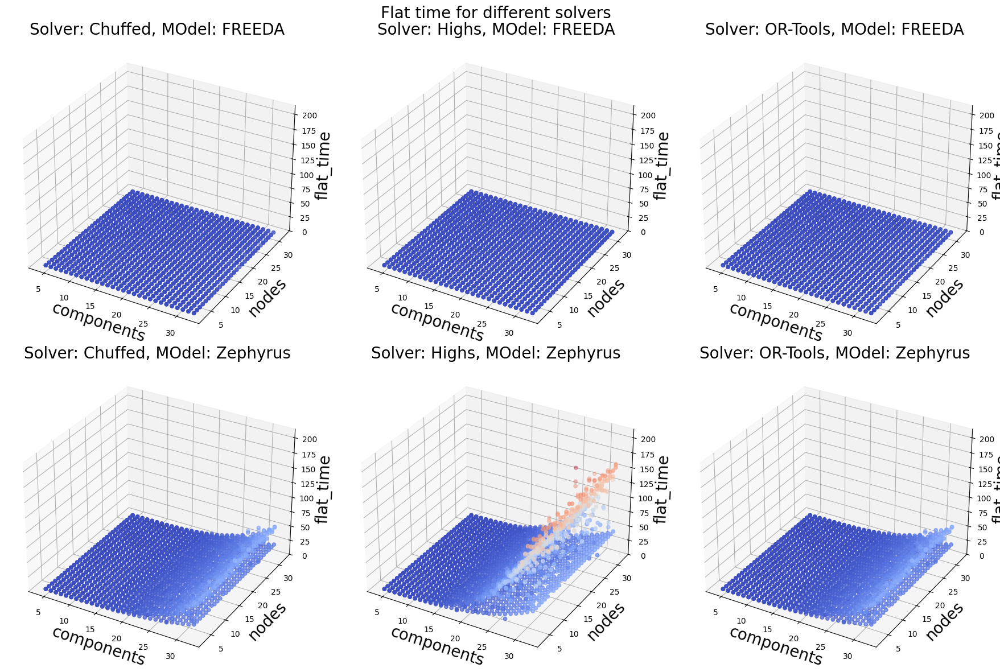

In [83]:
fig, axs = plt.subplots(
    nrows=len(models),
    ncols=len(solvers),
    figsize=(6 * len(solvers), 6 * len(models)),
    subplot_kw=dict(projection='3d')
)
norm = Normalize(vmin=0, vmax=df.flat_time.max())
for m, ax_row in zip(models, axs):
    for s, ax in zip(solvers, ax_row):
        d = df.query("model == @m").query("solver == @s")
        ax.scatter(
            xs=d.components,
            ys=d.nodes,
            zs=d.flat_time,
            c=d.flat_time,
            norm=norm,
            cmap="coolwarm",
            alpha=alpha
        )
        ax.set_zlim([0, df.flat_time.max()])
        ax.set_xlabel("components", fontsize=20)
        ax.set_ylabel("nodes", fontsize=20)
        ax.set_zlabel("flat_time", fontsize=20)
        ax.set_title("Solver: " + s + ", MOdel: " + m, fontsize=20)

fig.suptitle("Flat time for different solvers", fontsize=20)
fig.tight_layout()

### Topologies

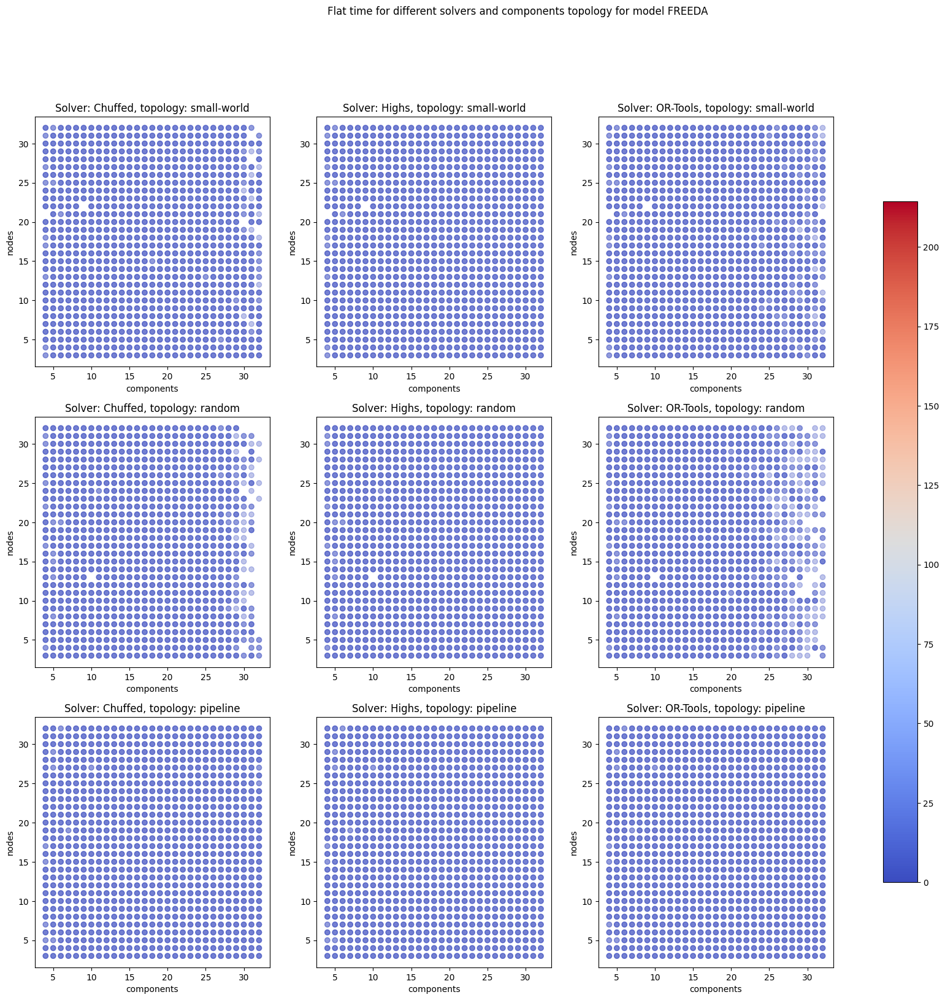

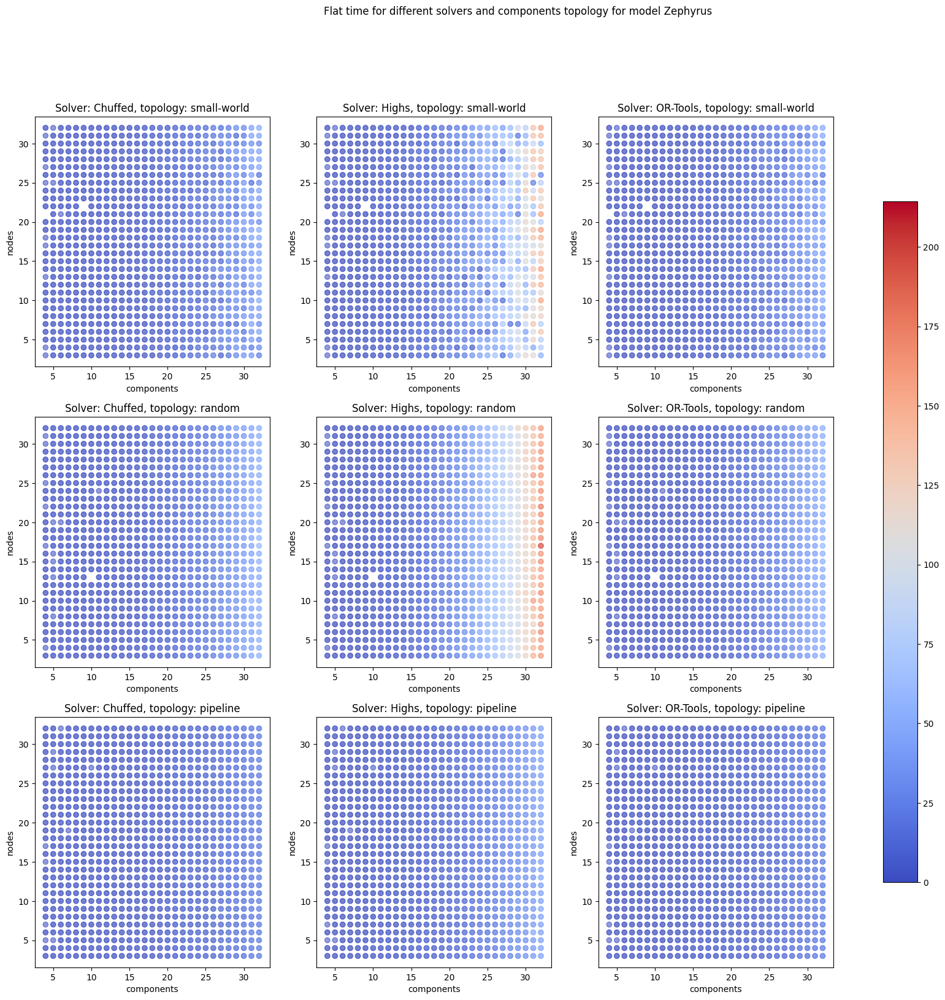

In [84]:
for m in models:
    fig, axs = plt.subplots(
        nrows=len(component_topologies),
        ncols=len(solvers),
        figsize=(7 * len(component_topologies), 6 * len(solvers))
    )
    axs_reshaped = axs.reshape(-1)
    axis = itertools.product(component_topologies, solvers)
    df_problem = df.query("model == @m")
    for (topology, solver), ax in zip(axis, axs_reshaped):
        d = df_problem.query("solver == @solver").query("comps_topology == @topology")
        ax.scatter(
            x=d.components,
            y=d.nodes,
            c=d.flat_time,
            cmap="coolwarm",
            norm=norm,
            alpha=alpha
        )
        ax.set_xlabel("components")
        ax.set_ylabel("nodes")
        ax.set_title("Solver: " + solver + ", topology: " + topology)

    fig.suptitle("Flat time for different solvers and components topology for model " + m)
    fig.colorbar(
        ScalarMappable(norm=norm, cmap="coolwarm"),
        ax=axs.ravel().tolist(),
        orientation='vertical',
        shrink=0.8
    )

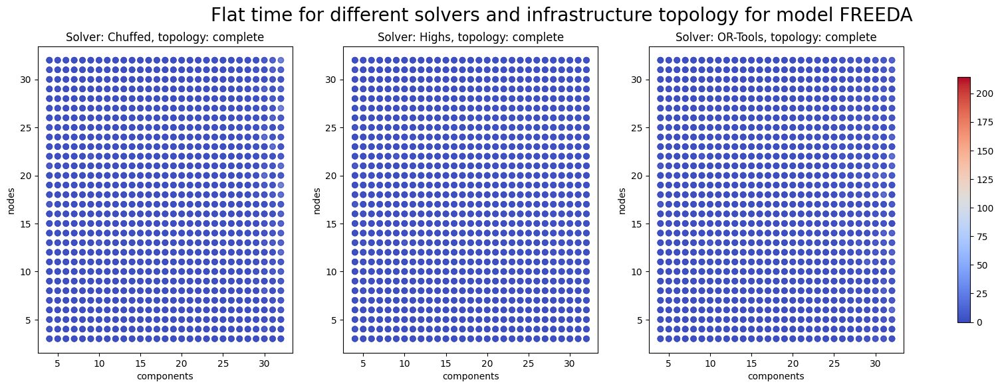

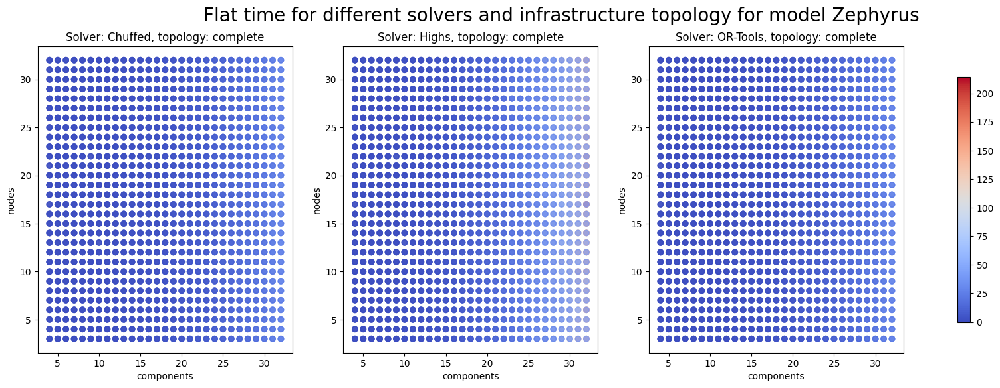

In [85]:
for m in models:
    fig, axs = plt.subplots(
        nrows=len(infrastructure_topologies),
        ncols=len(solvers),
        figsize=(7 * len(solvers), 6 * len(infrastructure_topologies))
    )
    axs_reshaped = axs.reshape(-1)
    axis = itertools.product(infrastructure_topologies, solvers)
    df_problem = df.query("model == @m")
    for (topology, solver), ax in zip(axis, axs_reshaped):
        d = df_problem.query("solver == @solver").query("infra_topology == @topology")
        ax.scatter(
            x=d.components,
            y=d.nodes,
            c=d.flat_time,
            cmap="coolwarm",
            norm=norm,
            alpha=alpha
        )
        ax.set_xlabel("components")
        ax.set_ylabel("nodes")
        ax.set_title("Solver: " + solver + ", topology: " + topology)

    fig.colorbar(
        ScalarMappable(norm=norm, cmap="coolwarm"),
        ax=axs.ravel().tolist(),
        orientation='vertical',
        shrink=0.8
    )
    fig.suptitle("Flat time for different solvers and infrastructure topology for model " + m, fontsize=20)

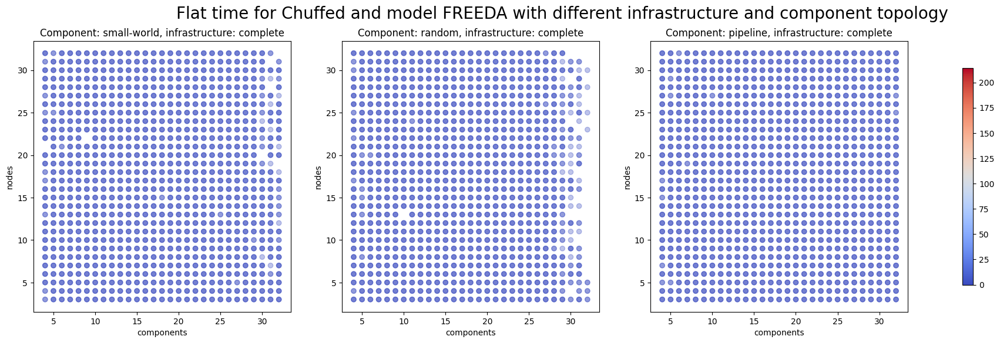

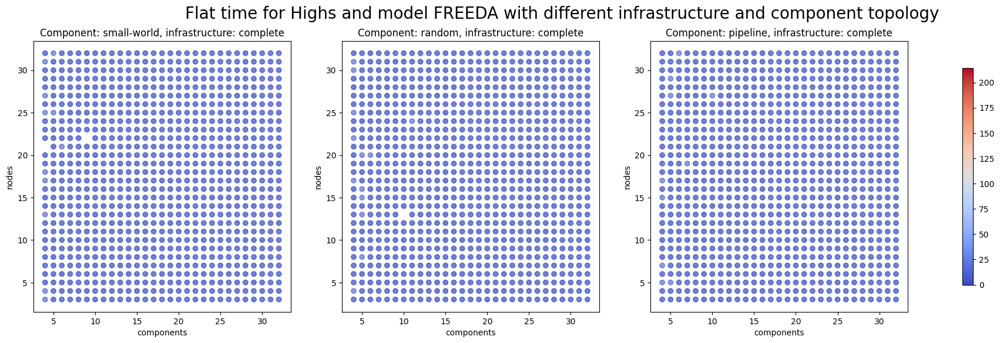

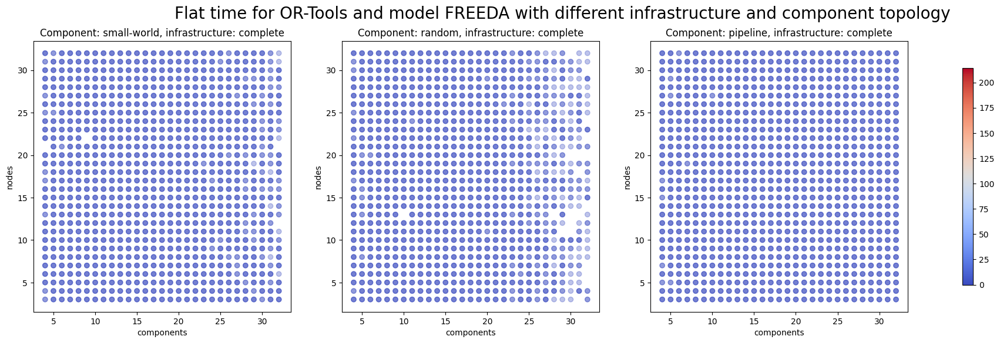

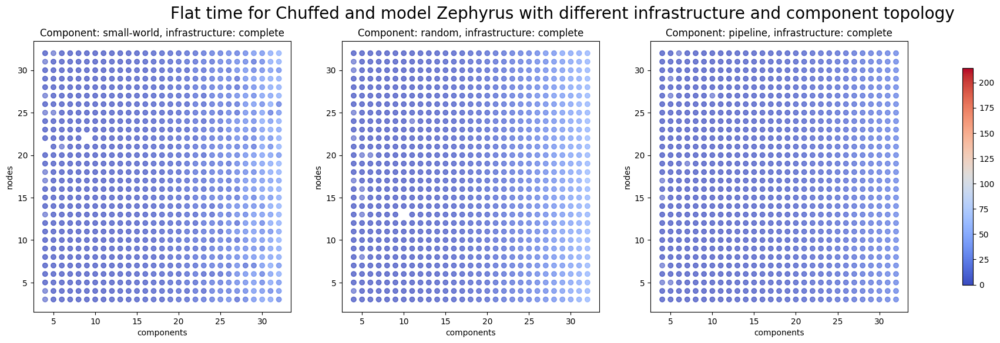

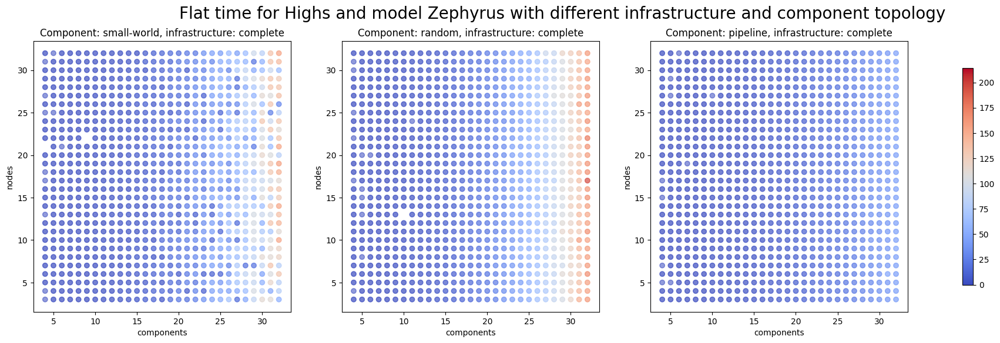

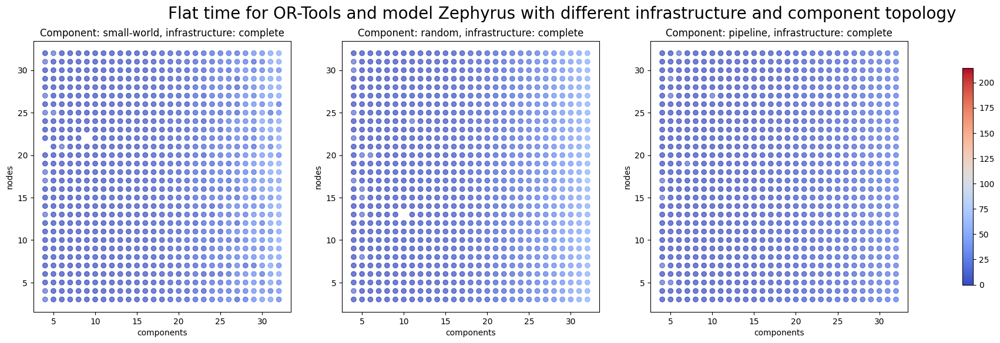

In [86]:
for m in models:
    for solver in solvers:
        fig, axs = plt.subplots(
            nrows=len(infrastructure_topologies),
            ncols=len(component_topologies),
            figsize=(8 * len(component_topologies), 6 * len(infrastructure_topologies))
        )
        axs_reshaped = axs.reshape(-1)
        axis = itertools.product(infrastructure_topologies, component_topologies)
        df_solver_problem = df.query("model == @m").query("solver == @solver")
        for (infra_topology, comps_topology), ax in zip(axis, axs_reshaped):
            d = df_solver_problem.query("infra_topology == @infra_topology").query("comps_topology == @comps_topology")
            ax.scatter(
                x=d.components,
                y=d.nodes,
                c=d.flat_time,
                cmap="coolwarm",
                norm=norm,
                alpha=alpha
            )
            ax.set_xlabel("components")
            ax.set_ylabel("nodes")
            ax.set_title("Component: " + comps_topology + ", infrastructure: " + infra_topology)

        fig.colorbar(
            ScalarMappable(norm=norm, cmap="coolwarm"),
            ax=axs.ravel().tolist(),
            orientation='vertical',
            shrink=0.8
        )
        fig.suptitle("Flat time for " + solver + " and model " + m + " with different infrastructure and component topology", fontsize=20)


# Flat time vs Solve time

In [87]:
ax.get_ylim()[1]

np.float64(33.45)

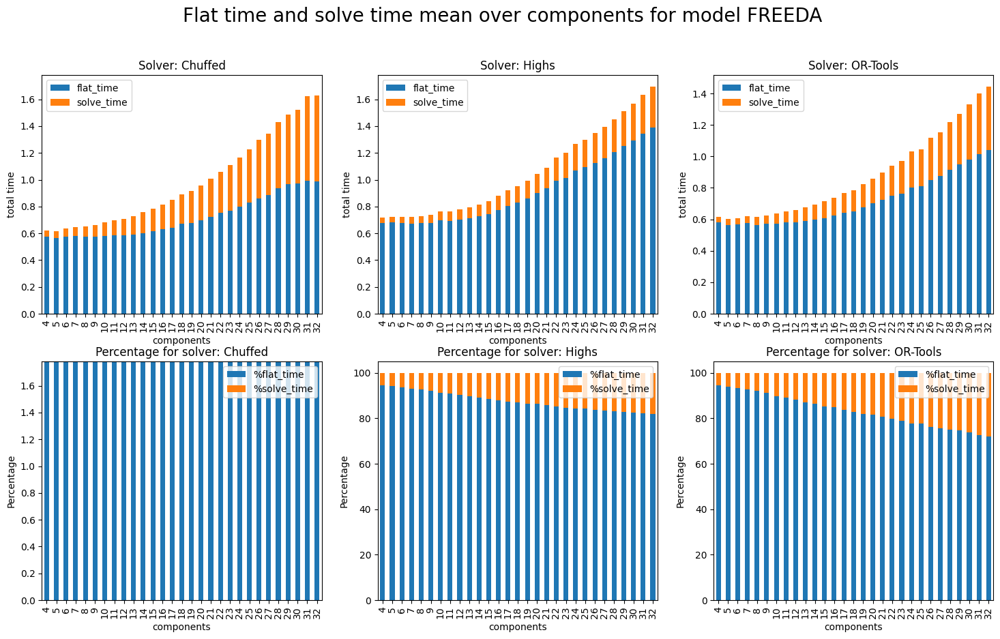

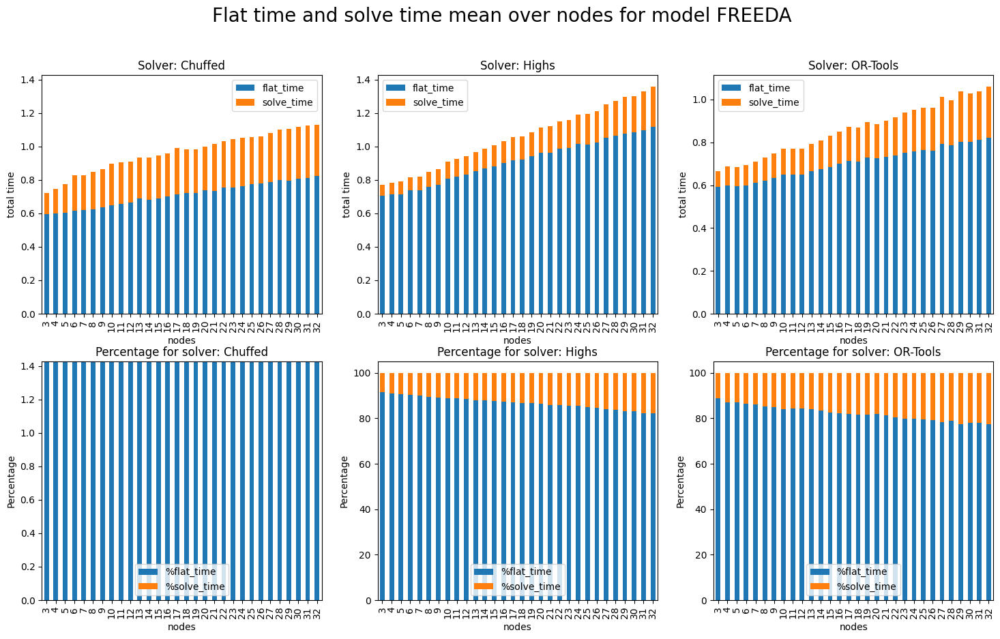

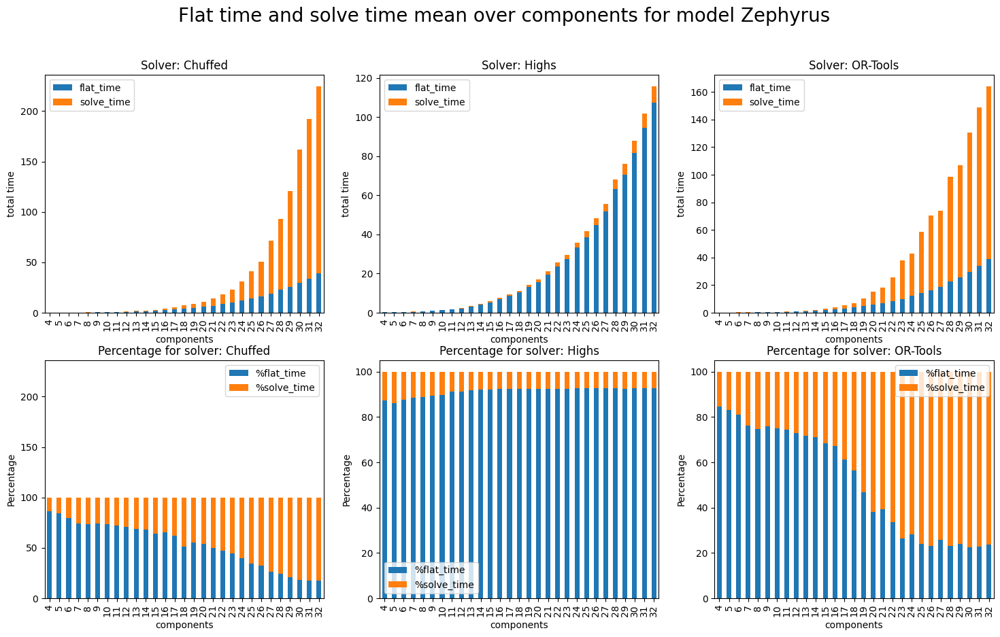

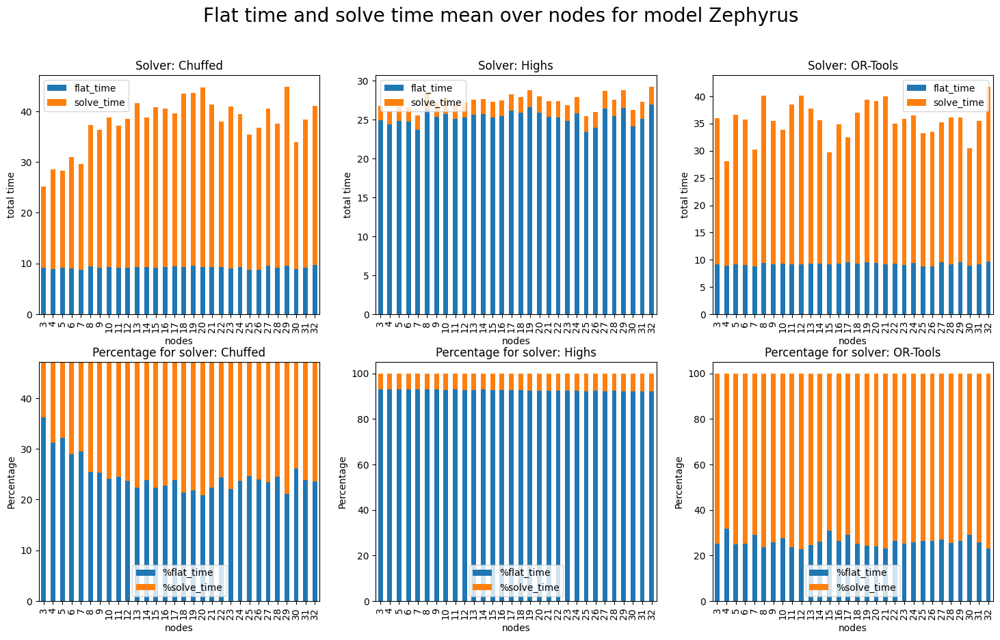

In [88]:
for m in models:
    for over in ["components", "nodes"]:
        fig, axs = plt.subplots(
            nrows=2,
            ncols=len(solvers),
            figsize=(6 * len(solvers), 10)
        )
        axs_reshaped = axs.reshape(-1)

        mx = 0
        for solver, (i, ax) in zip(solvers, enumerate(axs_reshaped)):
            times = (
                df
                .query("solver == @solver")
                .query("model == @m")
                .groupby(over)
                [["flat_time", "solve_time"]]
                .mean()
            )

            times.plot.bar(
                ax=ax,
                stacked=True,
                title="Solver: " + solver,
            )
            ax.set_ylabel("total time")

            times.assign(**{
                "%flat_time" : lambda df : df["flat_time"] / (df["solve_time"] + df["flat_time"]) * 100,
                "%solve_time" : lambda df : df["solve_time"] / (df["solve_time"] + df["flat_time"]) * 100
            }).drop(
                columns=["solve_time", "flat_time"]
            ).plot.bar(
                stacked=True,
                title="Percentage for solver: " + solver,
                ax=axs_reshaped[len(solvers) + i],
            )
            mx = max(mx, ax.get_ylim()[1])
            axs_reshaped[len(solvers) + i].set_ylabel("Percentage")

        fig.suptitle("Flat time and solve time mean over " + over + " for model " + m, fontsize=20)
        [ax[0].set_ylim([0, mx]) for ax in axs]
        plt.show()


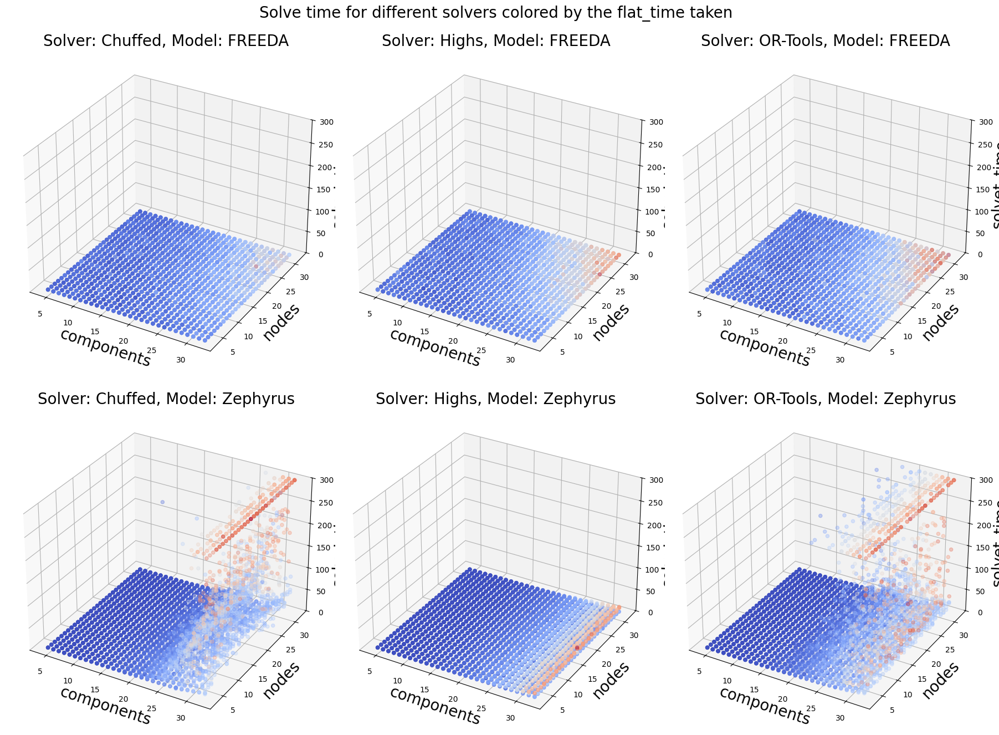

In [89]:
fig, axs = plt.subplots(
    nrows=len(models),
    ncols=len(solvers),
    figsize=(6 * len(solvers), 7 * len(models)),
    subplot_kw=dict(projection='3d')
)
for m, ax_row in zip(models, axs):
    for s, ax in zip(solvers, ax_row):
        d = df.query("model == @m").query("solver == @s")
        ax.scatter(
            xs=d.components,
            ys=d.nodes,
            zs=d.solve_time,
            c=d.flat_time,
            cmap="coolwarm",
            alpha=alpha
        )
        ax.set_xlabel("components", fontsize=20)
        ax.set_ylabel("nodes", fontsize=20)
        ax.set_zlabel("solvet_time", fontsize=20)
        ax.set_title("Solver: " + s + ", Model: " + m, fontsize=20)
        ax.set_zlim([0, df.solve_time.max()])

fig.suptitle("Solve time for different solvers colored by the flat_time taken", fontsize=20)
fig.tight_layout()

/var/folders/0c/_45bz49544131ywq145p6vn00000gn/T/ipykernel_58465/3900797237.py:23: UserWarning: Attempt to set non-positive ylim on a log-scaled axis will be ignored.
  [ax.set_ylim([0, mx]) for row in axs for ax in row]


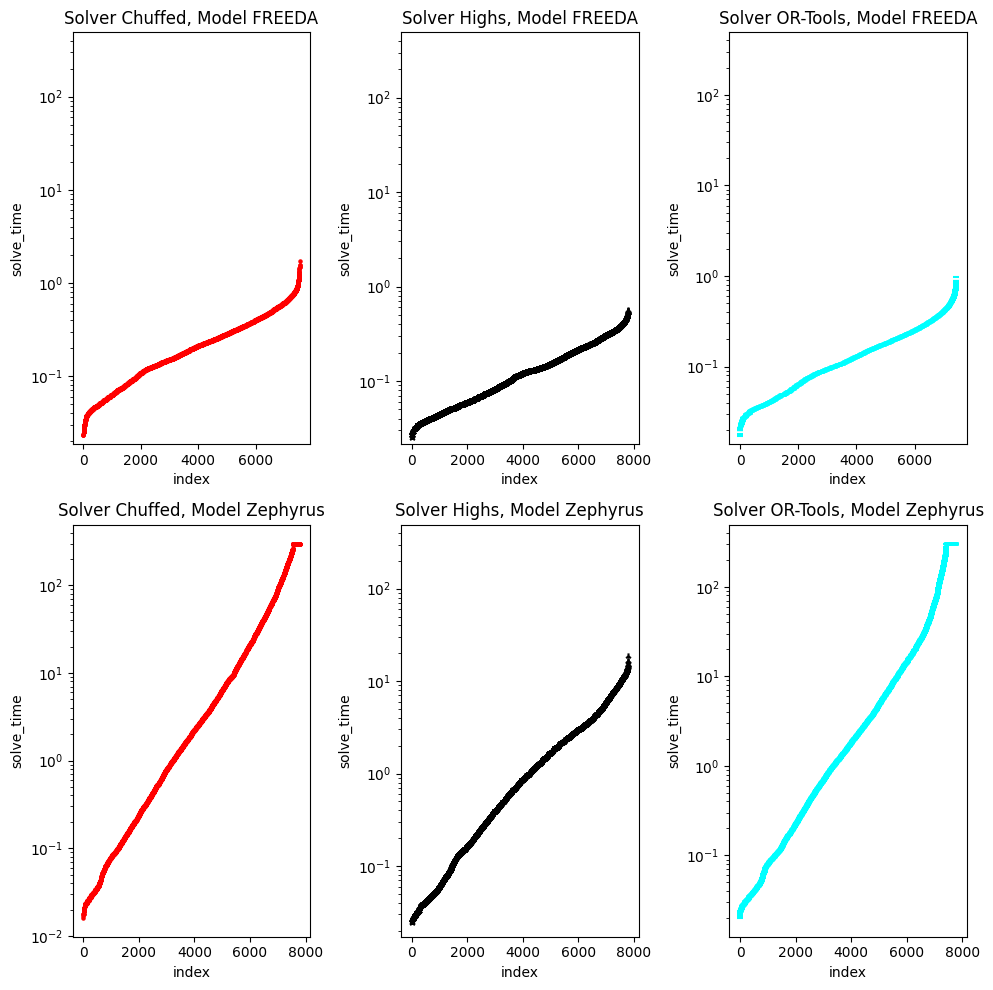

In [90]:
fig, axs = plt.subplots(
    nrows=len(models),
    ncols=len(solvers),
    figsize=(10, 10),
)

mx = 0
for m, ax_row in zip(models, axs):
    for s, ax in zip(solvers, ax_row):
        d = df.query("model == @m").query("solver == @s").solve_time.sort_values(ascending=True).reset_index(drop=True).reset_index()
        d.plot.scatter(
            x="index",
            y="solve_time",
            ax=ax,
            c=color[s],
            marker=marker[s]
        )

        ax.set_title("Solver " + s + ", Model " + m)
        ax.set_yscale('log')
        mx = max(mx, ax.get_ylim()[1])

[ax.set_ylim([0, mx]) for row in axs for ax in row]

fig.tight_layout()

# Paper images and tables

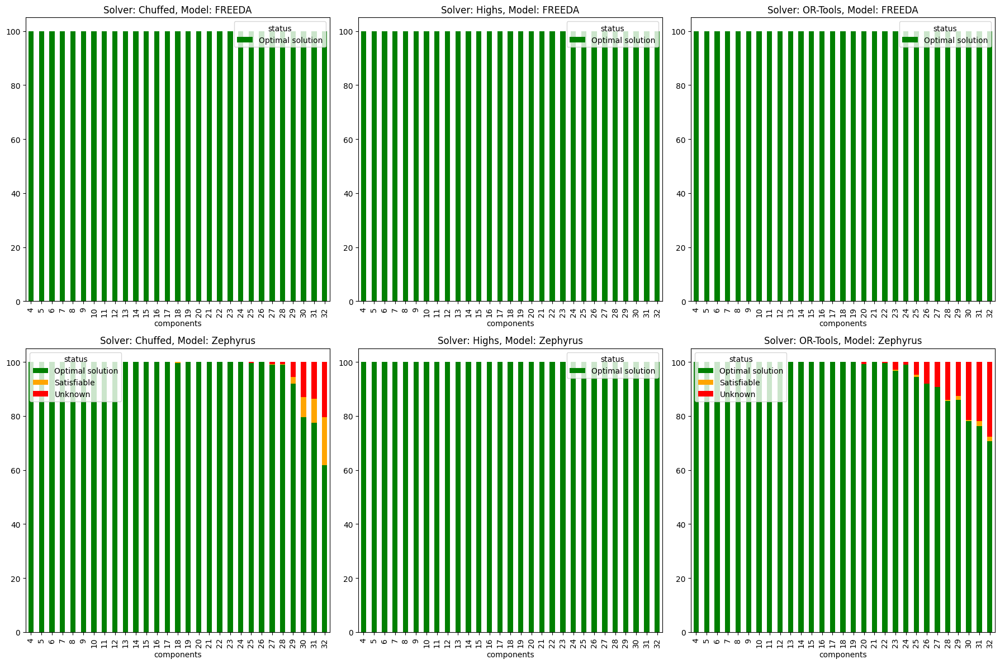

In [106]:
colors = {
    "Optimal solution": "green",
    "Unsatisfiable": "#1f77b4",
    "Unknown": "red",
    "Satisfiable" : "orange"
}
fig, axs = plt.subplots(
    nrows=2,
    ncols=len(solvers),
    figsize=(6 * len(solvers), 12)
)
norm = Normalize(vmin=0, vmax=100)
for model, ax_row in zip(models, axs):
    for solver, ax in zip(solvers, ax_row):
        d = (
            df.query("solver == @solver")
            .query("model == @model")
            [["components", "status"]]
            .groupby("components")
            .value_counts(normalize=True)
            * 100
        ).reset_index().pivot(
            index="components",
            columns="status",
            values="proportion"
        ).fillna(0)

        d.plot.bar(
            color=colors,
            stacked=True,
            ax=ax,
            title="Solver: " + solver + ", Model: " + model
        )

fig.tight_layout()
plt.show()

Text(0, 0.5, 'solve time difference')

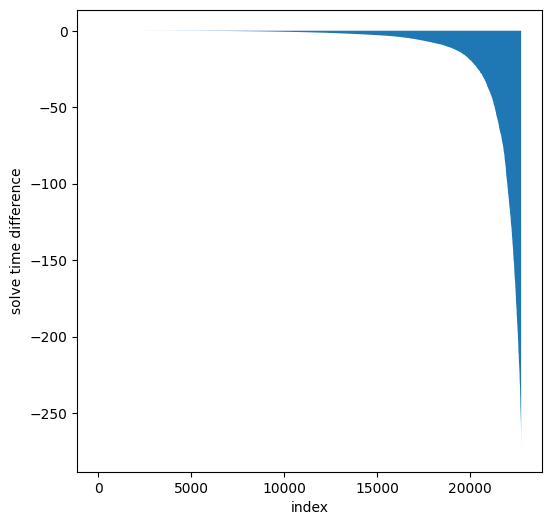

In [111]:
fig, ax = plt.subplots(1, 1, figsize=(6, 6))

area_plot = (
    df.query("model == 'FREEDA'").solve_time.sort_values().reset_index(drop=True)
    -
    df.query("model == 'Zephyrus'").solve_time.sort_values().reset_index(drop=True)
).reset_index()

ax.fill_between(area_plot.index, area_plot.solve_time)
ax.set_xlabel("index")
ax.set_ylabel("solve time difference")

In [112]:
save_fig(fig, "solve-time-diff-zeph")

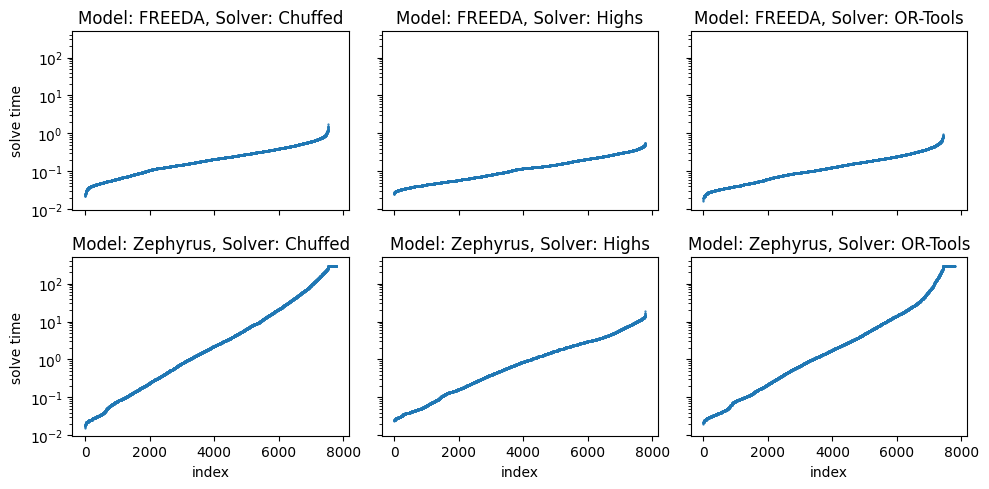

In [94]:
fig, axs = plt.subplots(
    nrows=len(models),
    ncols=len(solvers),
    sharex=True,
    sharey=True,
    figsize=(10, 5),
)

for model, ax_row in zip(models, axs):
    for solver, ax in zip(solvers, ax_row):
        (
            df.query("solver == @solver")
            .query("model == @model")
            .solve_time
            .sort_values(ascending=True)
            .reset_index(drop=True).reset_index()
            .plot.scatter(
                x="index",
                y="solve_time",
                s=0.3,
                ax=ax
            )
        )
        ax.set_title("Model: " + model + ", Solver: " + solver)
        ax.set_yscale('log')
        ax.set_ylabel("solve time")

fig.tight_layout()

In [95]:
save_fig(fig, "solve-time-log-zeph")

In [96]:
mean_solve_time = (
    df[["model", "solver", "solve_time"]]
    .groupby(["model", "solver"])
    .aggregate("mean")
    .rename(columns={"solve_time" : "mean solve time"})
    #.unstack()
    .map(lambda x : str(round(x, 2)) + "s")
)
mean_solve_time

mean solve time
model    solver                  
FREEDA   Chuffed            0.26s
         Highs              0.14s
         OR-Tools           0.16s
Zephyrus Chuffed           28.54s
         Highs              2.03s
         OR-Tools          26.46s

In [97]:
std_solve_time = (
    df[["model", "solver", "solve_time"]]
    .groupby(["model", "solver"])
    .aggregate("std")
    .rename(columns={"solve_time" : "st. dev. solve time"})
    #.unstack()
    .map(lambda x : str(round(x, 2)) + "s")
)
std_solve_time

st. dev. solve time
model    solver                      
FREEDA   Chuffed                0.21s
         Highs                   0.1s
         OR-Tools               0.13s
Zephyrus Chuffed               65.11s
         Highs                  2.82s
         OR-Tools              68.39s

In [98]:
opt_perc = (
    df[["model", "solver", "status"]]
    .groupby(["model", "solver"])
    .aggregate(lambda x : str(round((len(x[x.str.contains("Optimal solution")]) / len(x)) * 100, 2)) + "%")
    .rename(columns={"status" : "Optimality %"})
    #.unstack()
)
opt_perc

Optimality %
model    solver               
FREEDA   Chuffed        100.0%
         Highs          100.0%
         OR-Tools       100.0%
Zephyrus Chuffed         96.8%
         Highs          100.0%
         OR-Tools       95.43%

In [99]:
pd.concat([
    mean_solve_time,
    std_solve_time,
    opt_perc
], axis=1)

mean solve time st. dev. solve time Optimality %
model    solver                                                   
FREEDA   Chuffed            0.26s               0.21s       100.0%
         Highs              0.14s                0.1s       100.0%
         OR-Tools           0.16s               0.13s       100.0%
Zephyrus Chuffed           28.54s              65.11s        96.8%
         Highs              2.03s               2.82s       100.0%
         OR-Tools          26.46s              68.39s       95.43%

In [100]:
print(pd.concat([
    mean_solve_time,
    std_solve_time,
    opt_perc
], axis=1).to_latex(multirow=False))

\begin{tabular}{lllll}
\toprule
 &  & mean solve time & st. dev. solve time & Optimality % \\
model & solver &  &  &  \\
\midrule
FREEDA & Chuffed & 0.26s & 0.21s & 100.0% \\
 & Highs & 0.14s & 0.1s & 100.0% \\
 & OR-Tools & 0.16s & 0.13s & 100.0% \\
Zephyrus & Chuffed & 28.54s & 65.11s & 96.8% \\
 & Highs & 2.03s & 2.82s & 100.0% \\
 & OR-Tools & 26.46s & 68.39s & 95.43% \\
\bottomrule
\end{tabular}



Borda counting

|     s1 \ s2 | satisfied | unsatisfied |     unkown | optimized |
|-------------|-----------|-------------|------------|-----------|
|   satisfied | o, timing |         bug |        s_1 |       s_2 |
| unsatisfied |       bug |      timing |        s_1 |       bug |
|      unkown |       s_2 |         s_2 |        0-0 |       s_2 |
|   optimized |       s_1 |         bug |        s_1 |    timing |

where
- s_x means give one point to solver x and zero to the other solver
- o mean look at the objective value. If one solver gives a better answer, that
  solver wins one point and the other zero. If both are equals, look at the
  times
- bug means one of the two solver contains a bug
- timing mean look directly at the times
- 0-0 means that each solver gets zero points

In [101]:
def score(t1, t2):
    if t1 == 0 and t2 == 0:
        return (0.5, 0.5)
    else:
        return (
            t2 / (t1 + t2),
            t1 / (t1 + t2),
        )

def borda_count(x):
    try:
        model1 = x.iloc[0]
        model2 = x.iloc[1]

        status1 = model1.status
        status2 = model2.status

        obj1 = min(model1.objectives.values(), default=None)
        obj2 = min(model2.objectives.values(), default=None)

        t1 = int(model1.solve_time)
        t2 = int(model2.solve_time)
    except:
        print(x)

    if status1 == "Optimal solution":
        if status2 == "Optimal solution":
            if obj1 == obj2:
                return score(t1, t2)
            else:
                print("ERROR: BOTH SOLVERS SAY THEY REACHED OPTIMAL SOLUTION BUT THE VALUES ARE DIFFERENT")
        elif status2 == "Unsatisfiable":
            print("ERROR: ONE SOLVER REACHED THE OPTIMAL SOLUTION BUT THE OTHER ONE SAY UNSAT")
        else:
            return (1, 0)
    elif status1 == "Unknown":
        if status2 == "Unknown":
            return (0, 0)
        else:
            return (0, 1)
    elif status1 == "Unsatisfiable":
        if status2 == "Satisfiable" or status2 == "Optimal solution":
            print("ERROR: ONE SOLVER REACHED UNSAT BUT THE OTHER ONE SAY SAT/OPTIMAL")
        elif status2 == "Unknown":
            return (1, 0)
        else:
            return score(t1, t2)
    elif status1 == "Satisfiable":
        if status2 == "Unknown":
            return (1, 0)
        elif status2 == "Optimal solution":
            return (0, 1)
        elif status2 == "Satisfiable":
            if obj1 > obj2: # Minimization problem
                return (0, 1)
            elif obj1 < obj2:
                return (1, 0)
            else:
                return score(t1, t2)
        else:
            print("ERROR: ONE SOLVER REACHED SAT BUT THE OTHER ONE SAY UNSAT")

    # Exit results for errors
    return (0, 0)


In [102]:
scores = []
errors = []

df_model_solver = df.assign(**{
    "model_solver": lambda df : df.apply(lambda x : x.model + "-" + x.solver, axis=1)
}).drop(columns=["model", "solver", "flavours", "resources", "flat_time", "infra_topology", "optimal_solution"])

combinations = itertools.combinations([m + "-" + s for m, s in itertools.product(models, solvers)], r=2)

for model_solver1, model_solver2 in combinations:
    to_group = df_model_solver.query("model_solver == @model_solver1 or model_solver == @model_solver2")
    for _, group in to_group.groupby(["components", "nodes", "comps_topology", "test"]):
        if len(group) == 2: # Make sure that if an instance failed to run, this code will run anyway
            scores.append(group.assign(score=borda_count))

scores = (
    pd.concat(scores)
    [["model_solver", "score"]]
    .groupby("model_solver")
    .sum()
    .reset_index()
    .assign(**{
        "model" : lambda df : df.apply(lambda x : x.model_solver.split("-")[0], axis=1),
        "solver" : lambda df : df.apply(lambda x : x.model_solver.split("-")[1], axis=1)
    })
    .drop(columns=["model_solver"])
    [["model", "solver", "score"]]
    .sort_values("score", ascending=False)
)

In [103]:
scores

,model,solver,score
1,FREEDA,Highs,25460.000000
0,FREEDA,Chuffed,24550.231981
2,FREEDA,OR,24268.500000
4,Zephyrus,Highs,17557.816657
5,Zephyrus,OR,11507.244850
3,Zephyrus,Chuffed,10490.206513


In [104]:
print(scores.sort_values("score", ascending=False).to_latex(index=False))

\begin{tabular}{llr}
\toprule
model & solver & score \\
\midrule
FREEDA & Highs & 25460.000000 \\
FREEDA & Chuffed & 24550.231981 \\
FREEDA & OR & 24268.500000 \\
Zephyrus & Highs & 17557.816657 \\
Zephyrus & OR & 11507.244850 \\
Zephyrus & Chuffed & 10490.206513 \\
\bottomrule
\end{tabular}



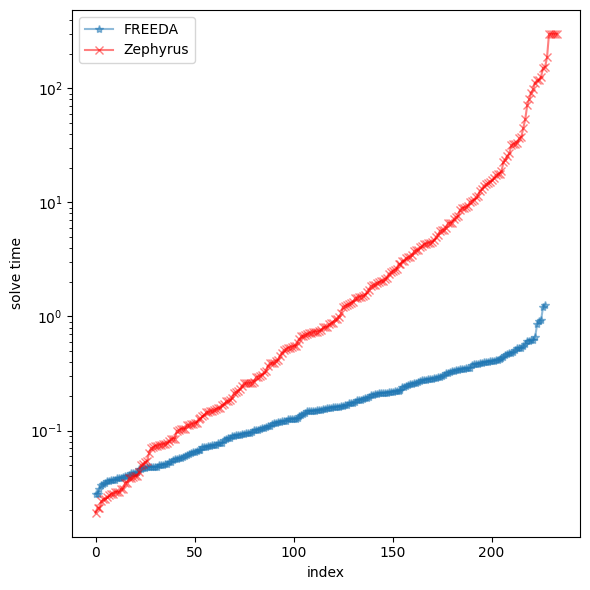

In [108]:
fig, ax = plt.subplots(
    nrows=1,
    ncols=1,
    figsize=(6, 6),
)

marker_model = {
    "FREEDA": "*",
    "Zephyrus": "x"
}
color_model = {
    "FREEDA": "#1f77b4",
    "Zephyrus": "red"
}

for model in models:
    (
        df
        .query("model == @model")
        .sample(frac=0.01)
        .solve_time
        .sort_values(ascending=True)
        .reset_index(drop=True).reset_index()
        .plot.line(
            x="index",
            y="solve_time",
            ax=ax,
            marker=marker_model[model],
            alpha=0.5,
            ms=6,
            linestyle="-",
            color=color_model[model],
            label=model
        )
    )
    ax.set_yscale('log')
    ax.set_ylabel("solve time")

fig.tight_layout()

In [109]:
save_fig(fig, "solve-time-distrib-zeph")

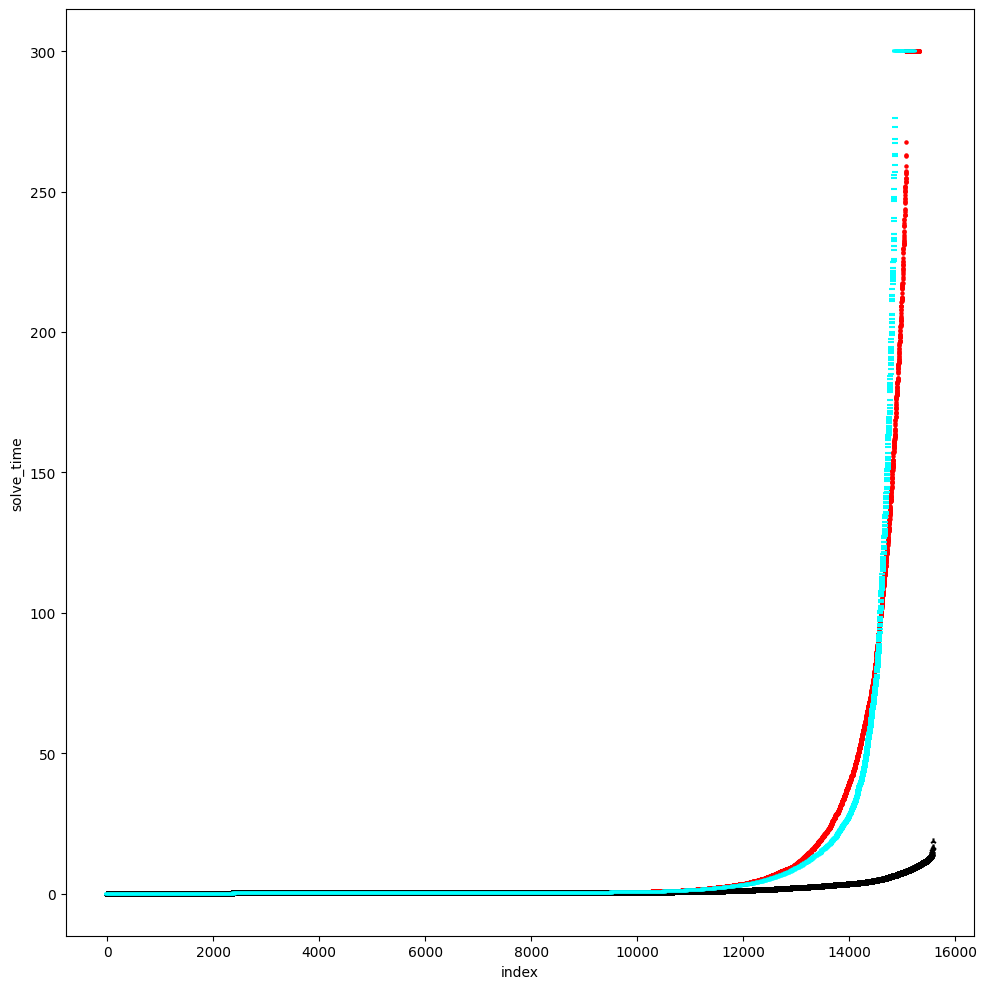

In [110]:
fig, ax = plt.subplots(
    nrows=1,
    ncols=1,
    figsize=(10, 10),
)

for solver in solvers:
    d = df.query("solver == @solver").solve_time.sort_values(ascending=True).reset_index(drop=True).reset_index()
    d.plot.scatter(x="index", y="solve_time", ax = ax, c=color[solver], marker=marker[solver])

fig.tight_layout()